In [1]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pyabf
import pyabf.filter
from sklearn.metrics import auc
from scipy import stats
import os
import csv
from scipy import optimize
import math

In [2]:
def name_con(f):
    n=os.path.basename(f)
    tn=n.split("_")
    if tn[1].lower()=='100':
        x='1:100'
    elif tn[1].lower()=='1k':
        x='1:1k'
    elif tn[1].lower()=='10k':
        x='1:10k'
    else:
        x=''
    name=x+' '+tn[2]
    return name

def EAG_PLT(FILE, save=False, ymin=-150, ymax=75):
    
    name=name_con(FILE)
    
    abf = pyabf.ABF(FILE)
    
    

    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, figsize=(18, 10))

    for sweep in abf.sweepList:
    
        abf.setSweep(sweep, channel=0,baseline=[0, 0.2])
        
        if abf.dataRate ==  10000:
            print('sampling rate is', abf.dataRate,'hz',' reducing rate to 1000hz')
            abf.sweepY=scipy.signal.decimate(abf.sweepY,10)
            abf.sweepX=scipy.signal.decimate(abf.sweepX,10)
        
        ax1.plot(abf.sweepX, abf.sweepY, color='black')
        print(len(abf.sweepY))
    ax1.set_ylabel(ylabel=abf.sweepLabelY, fontsize=20)
    ax1.set_title(label=name, size=30)
    ax1.tick_params(axis='y', labelsize=20)

    for sweep in abf.sweepList:
    
        abf.setSweep(sweep, channel=1,baseline=[0, 0.2])
        if abf.dataRate ==  10000:
            abf.sweepY=scipy.signal.decimate(abf.sweepY,10)
            abf.sweepX=scipy.signal.decimate(abf.sweepX,10)
            
        ax2.plot(abf.sweepX, abf.sweepY, color='red')


    ax2.set_ylabel(ylabel=abf.sweepLabelY, fontsize=20)
    ax2.set_xlabel(xlabel=abf.sweepLabelX, fontsize=20)
    ax2.tick_params(axis='y', labelsize=20)
    ax2.tick_params(axis='x', labelsize=20)


    ax1.set_ylim([ymin, ymax])
    ax1.tick_params(labelbottom=False, length=0)
    ax1.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)
    ax1.spines['bottom'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    
    if save == True:
        plt.savefig(FILE+'.svg')
    else:
        pass

    plt.show()
    


def Extract_Wave(FILE, CTRL, Dir):
    
    tn=re.split('\.|\\\\',FILE)
    abf=pyabf.ABF(FILE)
    ctrl=pyabf.ABF(CTRL)
    print(tn[4])    
    if abf.dataRate ==  10000:
        print('sampling rate is', abf.dataRate,'hz',' reducing rate to 1000hz')
        abf.setSweep(0,baseline=[0,1])
        abf.sweepY=scipy.signal.decimate(abf.sweepY,10)
        abf.sweepX=scipy.signal.decimate(abf.sweepX,10)
    if ctrl.dataRate ==  10000:
        print('sampling rate is', ctrl.dataRate,'hz',' reducing rate to 1000hz')
        abf.setSweep(0,baseline=[0,1])
        ctrl.sweepY=scipy.signal.decimate(ctrl.sweepY,10)
        ctrl.sweepX=scipy.signal.decimate(ctrl.sweepX,10)
            
    abf.sweepY=abf.sweepY-ctrl.sweepY
    wave1=abf.sweepY[5562:15562]
    wave2=abf.sweepY[36062:46062]
    wave3=abf.sweepY[66562:76562]
    
    with open(Dir + tn[4] +'_wave1.csv', 'w') as f1:
        write = csv.writer(f1)
        write.writerow(wave1)
    with open(Dir + tn[4] +'_wave2.csv', 'w') as f2:
        write = csv.writer(f2)
        write.writerow(wave2)
    with open(Dir + tn[4] +'_wave3.csv', 'w') as f3:
        write = csv.writer(f3)
        write.writerow(wave3)
    
def open_wave(FILE):
    with open(FILE, newline='') as f:
        reader = csv.reader(f)
        data = list(reader)
    f.close()
    l=data[0]
    l = list(map(float, l))
    return l

def csv_plot(FILE, NAME):
    t=open_wave(FILE)
    #n=NAME.split("\\")
    plt.title(label=NAME, size=10)
    plt.plot(t)

def find_PtT(DF, WF):
    ymin=DF[WF].min()
    indexymin=DF[WF].idxmin()
    y10=ymin*.1
    #x10ymin=DF.index[DF[WF].round(decimals=1)==np.round(y10,decimals=1)][0]
    tdf=DF.iloc[0:indexymin] # create new dataframe from the begining to the index of the yminimum for the index of y10
    xPeak1=tdf[WF].iloc[(tdf[WF]-y10).abs().argsort()[:2]].index[0]
    #print(xPeak1)
    PtoT=indexymin-xPeak1
    #print('y minimum is ', ymin)
    #print('index of y minimum is ', indexymin)
    #print('10 percent of y minimum is ', y10)
    #print('index of 10 percent of y minimum is ', x10ymin)
    #print('Peak to trough is', PtoT, 'mS')
    return PtoT, xPeak1

#find the trough to peak time in waveform 
def find_TtP(DF, WF):
    ymin=DF[WF].min()
    indexymin=DF[WF].idxmin()
    y10=ymin*.1
    
    tdf=DF.iloc[indexymin:3500]
    xPeak2=tdf[WF].iloc[(tdf[WF]-0).abs().argsort()[:2]].index[0]
    #print(xPeak1)
    TtoP=xPeak2-indexymin
    #print('y minimum is ', ymin)
    #print('index of y minimum is ', indexymin)
    #print('10 percent of y minimum is ', y10)
    #print('index of 10 percent of y minimum is ', x10ymin)
    #print('Peak to trough is', PtoT, 'mS')
    return TtoP, xPeak2


def find_PtT_normed_data(DF, WF):
    ymax=DF.loc[0:1000,WF].mean()
    ymin=DF[WF].min()
    indexymin=DF[WF].idxmin()
    y10=ymax*.9
    #x10ymin=DF.index[DF[WF].round(decimals=1)==np.round(y10,decimals=1)][0]
    tdf=DF.iloc[0:indexymin] # create new dataframe from the begining to the index of the yminimum for the index of y10
    xPeak1=tdf[WF].iloc[(tdf[WF]-y10).abs().argsort()[:2]].index[0]
    #print(xPeak1)
    PtoT=indexymin-xPeak1
    #print('y minimum is ', ymin)
    #print('index of y minimum is ', indexymin)
    #print('10 percent of y minimum is ', y10)
    #print('index of 10 percent of y minimum is ', x10ymin)
    #print('Peak to trough is', PtoT, 'mS')
    return PtoT, xPeak1, ymin

def find_TtP_normed_data(DF, WF):
    ymax=DF.loc[0:1000,WF].mean()
    ymin=DF[WF].min()
    indexymin=DF[WF].idxmin()
    y10=ymax*.9
    
    tdf=DF.iloc[indexymin:3500]
    xPeak2=tdf[WF].iloc[(tdf[WF]-y10).abs().argsort()[:2]].index[0]
    #print(xPeak1)
    TtoP=xPeak2-indexymin
    #print('y minimum is ', ymin)
    #print('index of y minimum is ', indexymin)
    #print('10 percent of y minimum is ', y10)
    #print('index of 10 percent of y minimum is ', x10ymin)
    #print('Peak to trough is', PtoT, 'mS')
    return TtoP, xPeak2

def AUC(DF, WF,xPeak1,xPeak2):
    AUC= auc(abs(DF[WF][xPeak1:xPeak2].index), abs(DF[WF][xPeak1:xPeak2]))
    return AUC





In [3]:
def WF_feat_extract(DF, WF):
    
    ymin      = DF[WF].min()
    indexymin = DF[WF].idxmin()
    y10       = ymin*.1
    tdf       = DF.iloc[0:indexymin]
    xPeak1    = tdf[WF].iloc[(tdf[WF]-0).abs().argsort()[:2]].index[0]
    PtoT      = indexymin-xPeak1
    tdf       = DF.iloc[indexymin:3500]
    xPeak2    = tdf[WF].iloc[(tdf[WF]-0).abs().argsort()[:2]].index[0]
    TtoP      = xPeak2 - indexymin
    PtP       = xPeak2-xPeak1
    A_UC       = AUC(DF, WF, xPeak1, xPeak2)
    dsl,_,_,_,_ = stats.linregress(x=DF[WF][xPeak1:DF[WF].idxmin()].index.astype('float64'),y=DF[WF][xPeak1:DF[WF].idxmin()].astype('float64'))
    usl,_,_,_,_ = stats.linregress(x=DF[WF][DF[WF].idxmin():xPeak2].index.astype('float64'),y=DF[WF][DF[WF].idxmin():xPeak2].astype('float64'))
    
    
    data_dict={'PeakToTrough':[PtoT],'Intensity':[ymin],'TroughToPeak':[TtoP],'PeakToPeak':[PtP],'DownSlope':[dsl],'UpSlope':[usl],'AreaUnderTheCurve':[A_UC]}
    #index=[WF]
    df=pd.DataFrame(data_dict)
    return df
def WF_feat_extract_normed_data(DF, WF):
    ymax      = DF.loc[0:1000,WF].mean()
    ymin      = DF[WF].min()
    indexymin = DF[WF].idxmin()
    y10       = ymax*.9
    tdf       = DF.iloc[0:indexymin]
    xPeak1    = tdf[WF].iloc[(tdf[WF]-1).abs().argsort()[:2]].index[0]
    PtoT      = indexymin-xPeak1
    tdf       = DF.iloc[indexymin:3500]
    xPeak2    = tdf[WF].iloc[(tdf[WF]-1).abs().argsort()[:2]].index[0]
    TtoP      = xPeak2 - indexymin
    PtP       = xPeak2-xPeak1
    A_UC       = AUC(DF, WF, xPeak1, xPeak2)
    dsl,_,_,_,_ = stats.linregress(x=DF[WF][xPeak1:DF[WF].idxmin()].index.astype('float64'),y=DF[WF][xPeak1:DF[WF].idxmin()].astype('float64'))
    usl,_,_,_,_ = stats.linregress(x=DF[WF][DF[WF].idxmin():xPeak2].index.astype('float64'),y=DF[WF][DF[WF].idxmin():xPeak2].astype('float64'))
    
    
    data_dict={'PeakToTrough':[PtoT],'Intensity':[ymin],'TroughToPeak':[TtoP],'PeakToPeak':[PtP],'DownSlope':[dsl],'UpSlope':[usl],'AreaUnderTheCurve':[A_UC]}
    #index=[WF]
    df=pd.DataFrame(data_dict)
    return df



In [4]:
All_df=pd.read_csv('/Users/joshswore/Manduca/Processed_Data/Smooth_Normalized_Independent_Waves_EAG_Vals.csv',index_col=0).T
All_df=All_df.T
All_df

,0,1,2,3,4,5,6,7,8,9,...,9993,9994,9995,9996,9997,9998,9999,label,concentration,date
060322m1a1100benzaldehyde0000.abfwave2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,benzaldehyde,100,060322m1a1
091522m1a13kbenzaldehyde0000.abfwave2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,benzaldehyde,3k,091522m1a1
092222m1a13kbenzaldehyde0001.abfwave3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,benzaldehyde,3k,092222m1a1
082322m2a11kbenzaldehyde0000.abfwave3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,benzaldehyde,1k,082322m2a1
060222m1a11kbenzaldehyde0000.abfwave1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,benzaldehyde,1k,060222m1a1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100322m1a11klimonene0000.abfwave3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,limonene,1k,100322m1a1
060222m1a11klimonene0000.abfwave3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,limonene,1k,060222m1a1
091422m1a1300limonene0000.abfwave1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,limonene,300,091422m1a1
091322m2a13klimonene0001.abfwave2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,limonene,3k,091322m2a1


In [5]:
Bhyde_df=All_df[All_df['label']=='benzaldehyde']
Balc_df=All_df[All_df['label']=='benzylalcohol']
Oct_df=All_df[All_df['label']=='1octen3ol']
YY_df=All_df[All_df['label']=='ylangylang']
Rose_df=All_df[All_df['label']=='roseoil']
Lem_df=All_df[All_df['label']=='lemonoil']
Lin_df=All_df[All_df['label']=='linalool']
Limo_df=All_df[All_df['label']=='limonene']


In [6]:
#step 1 seperate the channels
CH1=All_df.iloc[:,:10000].T*-1
#CH2=All_df.iloc[:,9000:-3].T
#CH2.index=CH2.index.astype(int)
CH1.index=CH1.index.astype(int)
#CH2=CH2.reset_index(drop=True).astype(float)

<AxesSubplot:>

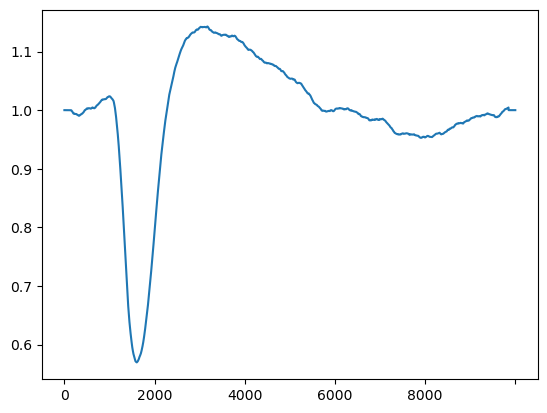

In [7]:
All_df.T['100322m1a11klimonene0000.abfwave3'][:-3].plot()

In [8]:
CH1=CH1-CH1.mean()

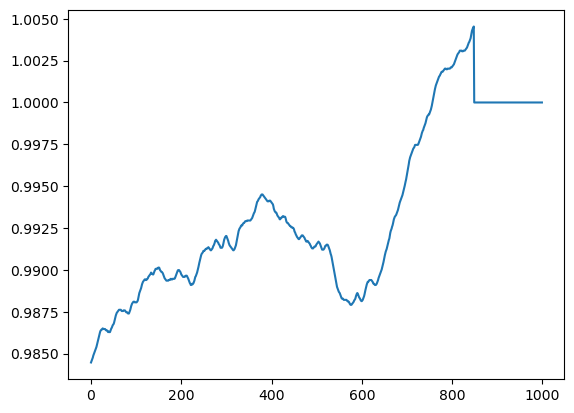

IndexError: index 0 is out of bounds for axis 0 with size 0

In [15]:
WAVE='100322m1a11klimonene0000.abfwave3'
#CH1=All_df.T[WAVE][:9000].T*-1
CH2=All_df.T[WAVE][9000:-3].T
CH2.index=CH2.index.astype(int)
CH1.index=CH1.index.astype(int)
CH2=CH2.reset_index(drop=True).astype(float)
CH1=pd.DataFrame(CH1)
CH2=pd.DataFrame(CH2)

#CH2[WAVE].plot()
phase1=pd.Series(CH2[WAVE][:2900][(CH2[WAVE] > 0)]).astype(float)
phase1.plot()
plt.show()
n2=pd.Series(CH2[WAVE][phase1.index[-1]:7500][(CH2[WAVE] < 0)]).astype(float)#find all negative values
phase2=pd.Series(CH2[WAVE][n2.index[0]:7500]).astype(float)
try:#create series that starts at first negative value after phas1 to the end
    P1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] > 0].index[25]
except IndexError:#find one of the first positive values after the negative base phase 2 wave. we skip a few of the first positive numbers to avoid fitting noise in our features.
    try:
        P1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] > 0].index[0]
    except:
        P1=phase2.index[-1]
phase2=phase2[:(P1-phase2.index[0])]#set phase two as the negative part of the wave. the phase stops when the wave goes positive

phase2.plot()

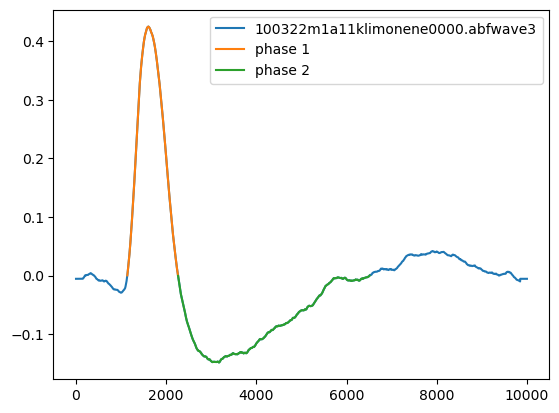

In [130]:

#step 2: Seperate each phase of the wave into wave 1 and wave 2

#we know the initial response occurs in the first half of the wave form.-> [:4500]
#we need to find all values greater than 0 to isolate the first phase of the wave -> 
#[(CH1['012623m2a11kbenzaldehyde0001wave2'] > 0)]
# to isolate the second phase we need to search for all values LESS that 0 after the end of the first phase
WAVE='100322m1a11klimonene0000.abfwave3'
phase1=pd.Series(CH1[WAVE][1000:2900][(CH1[WAVE] > 0)],index=CH1[WAVE][1000:2900][(CH1[WAVE] > 0)].index).astype(float)
phase2=pd.Series(CH1[WAVE][2000:7500][(CH1[WAVE] < 0)],index=CH1[WAVE][2000:7500][(CH1[WAVE] < 0)].index).astype(float)
#phase2=pd.Series(CH1[WAVE][len(phase1):7500]).astype(float)
CH1[WAVE].plot()

phase1.plot(label='phase 1')
phase2.plot(label='phase 2')
#CH1[WAVE][1000:2900][(CH1[WAVE] > 0)].astype(float).plot()
plt.legend()


#phase1.plot()
#phase2.plot()
#plt.axvline(start1,c='green')
#plt.axvline(stop1,c='red')
#plt.axvline(start2,c='lightgreen')
#plt.axvline(stop2,c='brown')
#plt.axhline(P2peak,c='red')
#plt.axhline(P2peak*.1,c='brown')



In [134]:
phase1=phase1.reset_index(drop=True).astype(float)
#phase2=phase2.reset_index(drop=True).astype(float)
#phase2=-phase2

In [138]:
#1. peak intensity
#P2peak = phase2.max()
P1peak = phase1.max()
#P2peak

In [139]:
P1peak*.1

0.04251581504817762

In [140]:
#lets find the start and stop of the phase 1 slope which we will define as a 10%,90% of the maximum intensity
start1=phase1[:phase1.idxmax()][phase1[:phase1.idxmax()] < (P1peak*.1)].idxmax()
print(start1)
stop1=np.sort(phase1[start1:phase1.idxmax()][phase1[start1:phase1.idxmax()] > (phase1.max()*.9)].index)[0]
print(stop1)

53
340


In [141]:
#2. upslope wave 1

#now we need to find the "upslope" of phase 1

usl,Uintercept,_,_,_ = stats.linregress(x=phase1.loc[start1:stop1].index,y=phase1.loc[start1:stop1])
phase1.loc[start1:stop1].index


RangeIndex(start=53, stop=341, step=1)

In [142]:
print(phase1.idxmax())
print(phase1[phase1.idxmax():])

463
463     0.425158
464     0.425158
465     0.425121
466     0.425084
467     0.425010
          ...   
1120    0.002380
1121    0.001825
1122    0.001269
1123    0.000714
1124    0.000195
Name: 100322m1a11klimonene0000.abfwave3, Length: 662, dtype: float64


In [143]:
start2=phase1[phase1.idxmax():][phase1[phase1.idxmax():] > (phase1.max()*.9)].idxmax()
try:
    stop2=np.sort(phase1[start2:][phase1[start2:]  < (phase1.max()*.1)].index)[0]
except IndexError:
    stop2=len(phase1)
#now find the slope and intercept phase 1

dsl,Dintercept,_,_,_ = stats.linregress(x=phase1[start2:stop2].index,y=phase1[start2:stop2])
print(start1,stop1,start2,stop2)

53 340 463 1053


[]

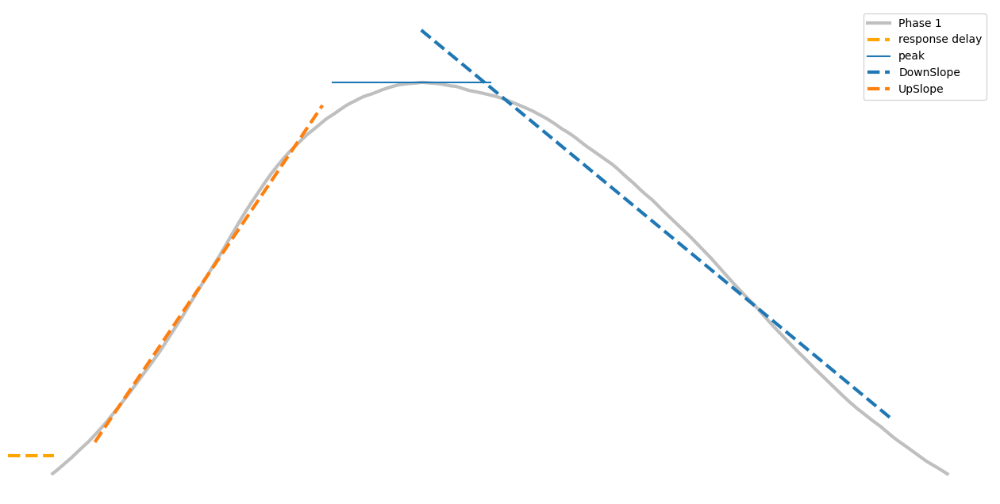

In [176]:
plt.figure(figsize=(16,8))
phase1
plt.plot(phase1,label='Phase 1', linewidth=3, c='grey',alpha=.5)
plt.axhline(.02,xmin=0,xmax=(start1/phase1.index[-1]), linestyle='--', linewidth=3,c='orange',label='response delay')
#plt.axvline(start1,label='start', linestyle='--',color='g')
#plt.axvline(stop1, label='stop', linestyle='--',color='r')
plt.axhline(P1peak,xmin=.33,xmax=.49,label='peak')

f2 = lambda x: dsl*x + Dintercept


f1 = lambda x: usl*x + Uintercept
x1 = range(start1,stop1)
x2 = phase1[start2:stop2].index
plt.plot(x2,f2(x2),linestyle='--', label='DownSlope', linewidth=3)
plt.plot(x1,f1(x1),linestyle='--', label='UpSlope', linewidth=3)
plt.axvline(start1,linestyle='--',)
plt.axvline(phase1.idxmax(),linestyle='--')
plt.axvline(stop2,linestyle='--')


plt.legend()
ax = plt.gca()
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
# Hide X and Y axes label marks
ax.xaxis.set_tick_params(labelbottom=False)
ax.yaxis.set_tick_params(labelleft=False)

# Hide X and Y axes tick marks
ax.set_xticks([])
ax.set_yticks([])

In [177]:
np.sort(phase2[start2:][phase2[start2:]  < (phase2.max()*.1)].index)

array([2726, 2727, 2728, ..., 6506, 6507, 6508])

In [178]:
#2. upslope wave 1

#now we need to find the "upslope" of phase 1
#lets find the start and stop of the phase 1 slope which we will define as a 10%,90% of the maximum intensity
start1=phase1[:phase1.idxmax()][phase1[:phase1.idxmax()] < (phase1.max()*.051)].idxmax()
stop1=phase1[start1:phase1.idxmax()][phase1[start1:phase1.idxmax()] > (phase1.max()*.9)].idxmax()

#now find the slope and intercept phase 1
usl,Uintercept,_,_,_ = stats.linregress(x=phase1[start1:stop1].index,y=phase1[start1:stop1])

print(start1,stop1)

28 462


In [179]:
#3. downslope phase 1
#repeat the process except using the downslope portion of phase1
start2=phase1[phase1.idxmax():][phase1[phase1.idxmax():] < (phase1.max()*.9)].idxmax()
stop2=phase1[start2:][phase1[start2:]  < (phase1.max()*.1)].idxmax()
print(start2,stop2)
dsl,Dintercept,_,_,_ = stats.linregress(x=phase1[start2:stop2].index,y=phase1[start2:stop2])



627 1053


In [180]:
#4. time to peak phase 1
#5. time to return phase 1
#6. Response Delay phase 1 (this will not be calculated in phase to as it is not relevant)
#this will take into consideration the time it takes for the antenna to respond which is a delay of a few ms

TtoP=phase1.idxmax()-start1 #time from onset of wave to peak intensity
PtoT=len(phase1[phase1.idxmax():stop2])#return to baseline from peak
ResponseDelay=start1#time from onset of odor delivery to begining of wave response


TtoP,PtoT,ResponseDelay

(435, 590, 28)

In [181]:
#7. AUC phase 1
auc(abs(phase1[start1:stop2].index), abs(phase1[start1:stop2]))


273.88116710978954

<AxesSubplot:>

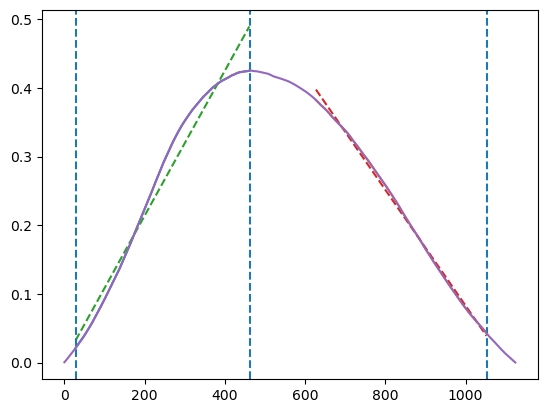

In [182]:
#fit function
f1 = lambda x: usl*x + Uintercept
f2 = lambda x: dsl*x + Dintercept
# x values of line to plot
x1 = phase1[start1:stop1].index
x2 = phase1[start2:stop2].index
# plot fit
plt.plot(phase1[start1:stop1].index,phase1[start1:stop1])
plt.plot(phase1[start2:stop2].index,phase1[start2:stop2])
plt.plot(x1,f1(x1),linestyle='--')
plt.plot(x2,f2(x2),linestyle='--')
plt.axvline(start1,linestyle='--')
plt.axvline(phase1.idxmax(),linestyle='--')
plt.axvline(stop2,linestyle='--')
phase1.plot()

In [24]:
#Features to extract
#1. peak intensity phase 1
#2. upslope phase 1 
#3. downslope phase 1
#4. time to peak phase 1
#5. time to return phase 1
#6. AUC phase 1
#7. upslope phase 2
#8. peak intensity phase 2
#9. downslope phase 2
#10. time to peak phase 2
#11. time to return phase 2
#12. AUC phase 2
#13. Cross correlations of each channel


In [26]:
#for the sake of ease we can simply flip the sing of phase 2 and apply the same code for phase1 to phase 2 now 
phase2=-phase2

In [27]:
#calculate the peak intensity of phase2 which will have the opposite sign of phase 2
P2peak = phase2.max()

In [28]:
#2. upslope wave 2

#now we need to find the "upslope" of phase 2
#lets find the P2start and P2stop of the phase 2 slope which we will define as a 10%,90% of the maximum intensity
P2start1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] < (phase2.max()*.1)].idxmax()
P2stop1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] < (phase2.max()*.9)].idxmax()
P2start2=phase2[phase2.idxmax():][phase2[phase2.idxmax():] < (phase2.max()*.9)].idxmax()
P2stop2=phase2[phase2.idxmax():][phase2[phase2.idxmax():]  < (phase2.max()*.1)].idxmax()

print(P2start1,P2stop1,P2start2,P2stop2)

#now find the slope and intercept phase 1
P2usl,P2Uintercept,_,_,_ = stats.linregress(x=phase2[P2start1:P2stop1].index,y=phase2[P2start1:P2stop1])

4066 4071 4074 4082


In [29]:
#3. downslope phase 2
#repeat the process except using the downslope portion of phase2
P2start2=phase2[phase2.idxmax():][phase2[phase2.idxmax():] < (phase2.max()*.9)].idxmax()
P2stop2=phase2[phase2.idxmax():][phase2[phase2.idxmax():]  < (phase2.max()*.1)].idxmax()

P2dsl,P2Dintercept,_,_,_ = stats.linregress(x=phase2[P2start2:P2stop2].index,y=phase2[P2start2:P2stop2])



In [30]:
#4. time to peak phase 2
#5. time to return phase 2

P2TtoP=phase2.idxmax()-P2start1 #time from onset of wave to peak intensity
P2PtoT=len(phase2[phase2.idxmax():P2stop2])#return to baseline from peak


P2TtoP,P2PtoT

(6, 10)

In [31]:
#7. AUC phase 2
auc(abs(phase2[P2start1:P2stop2].index), abs(phase2[P2start1:P2stop2]))

0.021498128943309543

<AxesSubplot:>

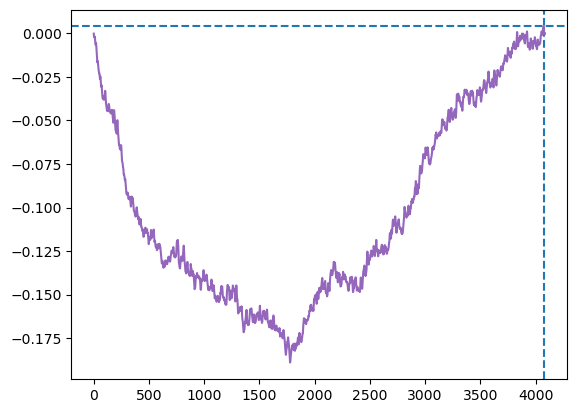

In [32]:
#fit function
p2f1 = lambda x: P2usl*x + P2Uintercept
p2f2 = lambda x: P2dsl*x + P2Dintercept
# x values of line to plot
p2x1 = phase2[P2start1:P2stop1].index
p2x2 = phase2[P2start2:P2stop2].index
# plot fit
plt.plot(phase2[P2start1:P2stop1].index,phase2[P2start1:P2stop1])
plt.plot(phase2[P2start2:P2stop2].index,phase2[P2start2:P2stop2])
plt.plot(p2x1,p2f1(p2x1),linestyle='--')
plt.plot(p2x2,p2f2(p2x2),linestyle='--')
#plt.axvline(start1,linestyle='--')
plt.axhline(P2peak,linestyle='--')
plt.axvline(phase2.idxmax(),linestyle='--')
#plt.axvline(stop2,linestyle='--')
phase2.plot()

In [3]:
def ChSeperator(DF, W):    
    CH1=DF[W][:9000].T*-1
    CH2=DF[W][9000:-3].T
    CH2.index=CH2.index.astype(int)
    CH1.index=CH1.index.astype(int)
    CH2=CH2.reset_index(drop=True).astype(float)
    return pd.DataFrame(CH1), pd.DataFrame(CH2)

def PhasesSeperator(DF, W):
    phase1=pd.Series(DF[W][:2900][(DF[W] > 0)]).astype(float)
    #phase2=pd.Series(DF[W][len(phase1):7500][(DF[W] < 0)]).astype(float)
    n2=pd.Series(DF[W][phase1.index[-1]:7500][(DF[W] < 0)]).astype(float)#find all negative values
    phase2=pd.Series(DF[W][n2.index[0]:7500]).astype(float)#create series that starts at first negative value after phas1 to the end
    try:#create series that starts at first negative value after phas1 to the end
        P1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] > 0].index[25]
    except IndexError:#find one of the first positive values after the negative base phase 2 wave. we skip a few of the first positive numbers to avoid fitting noise in our features.
        try:
            P1=phase2[:phase2.idxmax()][phase2[:phase2.idxmax()] > 0].index[0]
        except:
            P1=phase2.index[-1]
    phase2=phase2[:(P1-phase2.index[0])]
    
    phase1=phase1.reset_index(drop=True).astype(float)
    phase2=phase2.reset_index(drop=True).astype(float)
    phase2=-phase2
    return phase1, phase2

def StartStop(P):
    #stop1=np.sort(phase2[start1:phase2.idxmax()][phase2[start1:phase2.idxmax()] > (phase2.max()*.9)].index)[0]
    S1=P[:P.idxmax()][P[:P.idxmax()] < (P.max()*.1)].idxmax()
    Sp1=np.sort(P[S1:P.idxmax()][P[S1:P.idxmax()] > (P.max()*.9)].index)[0]
    S2=P[P.idxmax():][P[P.idxmax():] > (P.max()*.9)].idxmax()
    try:
        Sp2=np.sort(P[S2:][P[S2:]  < (P.max()*.1)].index)[0]
    except IndexError:
        Sp2=len(P)
    #print(S1,Sp1,S2,Sp2)
    return S1,Sp1,S2,Sp2

def FeatureExtracter(DF, W):
    CHL = [CH1, CH2] = ChSeperator(DF, W)
    CH1_dict = {'Response Delay':[],'Phase1 Intensity':[],'Phase1 Time to Peak':[],
               'Phase1 Peak to Baseline':[],'Phase1 Length':[],'Phase1 DownSlope':[],
               'Phase1 UpSlope':[], 'Phase1 AUC':[],
               
               'Phase2 Intensity':[],'Phase2 Time to Peak':[],
               'Phase2 Peak to Baseline':[],'Phase2 Length':[],'Phase2 DownSlope':[],
               'Phase2 UpSlope':[], 'Phase2 AUC':[]}
    
    CH2_dict = {'Response Delay':[],'Phase1 Intensity':[],'Phase1 Time to Peak':[],
               'Phase1 Peak to Baseline':[],'Phase1 Length':[],'Phase1 DownSlope':[],
               'Phase1 UpSlope':[], 'Phase1 AUC':[],
               
               'Phase2 Intensity':[],'Phase2 Time to Peak':[],
               'Phase2 Peak to Baseline':[],'Phase2 Length':[],'Phase2 DownSlope':[],
               'Phase2 UpSlope':[], 'Phase2 AUC':[]}
    
    DL = [CH1_dict,CH2_dict]
    CH_count=1
    for CH,CH_dict in zip(CHL,DL):
        print('Feature Engineering Channel: ', CH_count)
        PL = [P1, P2] = PhasesSeperator(CH, W)
        CH_dict['Phase1 Intensity'].append(P1.max())#
        CH_dict['Phase2 Intensity'].append(P2.max())#
        CH_dict['Response Delay'].append(StartStop(P1)[0])
        PCount=1
        CH_count+=1
        for P in PL:
            print('Count:', PCount)
            
            if PCount==1:
                print('extracting phase 1 features')
                S1,Sp1,S2,Sp2=StartStop(P)
                #print(S1,Sp1,S2,Sp2)
                #usl,Uintercept,_,_,_ = stats.linregress(x=PP[S1:Sp1].index,y=P[S1:Sp1])
                try:
                    CH_dict['Phase1 UpSlope'].append(stats.linregress(x=P[S1:Sp1].index,y=P[S1:Sp1])[0])
                except:
                    CH_dict['Phase1 UpSlope'].append(np.nan)
                #dsl,Dintercept,_,_,_ = stats.linregress(x=PP[S2:Sp2].index,y=P[S2:Sp2])
                try:
                    CH_dict['Phase1 DownSlope'].append(stats.linregress(x=P[S2:Sp2].index,y=P[S2:Sp2])[0])   
                except:
                    CH_dict['Phase1 DownSlope'].append(np.nan)
                #TtoP=P.idxmax()-S1
                try:
                    CH_dict['Phase1 Time to Peak'].append(P.idxmax()-S1)
                except:
                    CH_dict['Phase1 Time to Peak'].append(np.nan)
                #PtoT=len(P[P.idxmax():Sp2])
                try:
                    CH_dict['Phase1 Peak to Baseline'].append(len(P[P.idxmax():Sp2]))
                except:
                    CH_dict['Phase1 Peak to Baseline'].append(np.nan)
                #PhaseLength=PtoT+TtoP
                try:
                    CH_dict['Phase1 Length'].append(len(P[P.idxmax():Sp2])+(P.idxmax()-S1))
                except:
                    CH_dict['Phase1 Length'].append(np.nan)
                #AreaUC=auc(abs(P[S1:Sp2].index), abs(P[S1:Sp2]))
                try:
                    CH_dict['Phase1 AUC'].append(auc(abs(P[S1:Sp2].index), abs(P[S1:Sp2]))) 
                except:
                    CH_dict['Phase1 AUC'].append(np.nan)
                PCount+=1
                                                 
            elif PCount==2:
                print('extracting phase 2 features')
                S1,Sp1,S2,Sp2=StartStop(P)
                #print(P[S1:Sp1]),print(P[S2:Sp2])
                #usl,Uintercept,_,_,_ = stats.linregress(x=PP[S1:Sp1].index,y=P[S1:Sp1])
                try:
                    CH_dict['Phase2 UpSlope'].append(stats.linregress(x=P[S1:Sp1].index,y=P[S1:Sp1])[0])
                except:
                    CH_dict['Phase2 UpSlope'].append(np.nan)
                #dsl,Dintercept,_,_,_ = stats.linregress(x=PP[S2:Sp2].index,y=P[S2:Sp2])
                try:
                    CH_dict['Phase2 DownSlope'].append(stats.linregress(x=P[S2:Sp2].index,y=P[S2:Sp2])[0])
                except:
                    CH_dict['Phase2 DownSlope'].append(np.nan)
                #TtoP=P.idxmax()-S1
                try:
                    CH_dict['Phase2 Time to Peak'].append(P.idxmax()-S1)
                except:
                    CH_dict['Phase2 Time to Peak'].append(np.nan)
                #PtoT=len(P[P.idxmax():Sp2])
                try:
                    CH_dict['Phase2 Peak to Baseline'].append(len(P[P.idxmax():Sp2]))
                except:
                    CH_dict['Phase2 Peak to Baseline'].append(np.nan)
                #PhaseLength=PtoT+TtoP
                try:
                    CH_dict['Phase2 Length'].append(len(P[P.idxmax():Sp2])+(P.idxmax()-S1))                                 
                except:
                    CH_dict['Phase2 Length'].append(np.nan)
                #AreaUC=auc(abs(P[S1:Sp2].index), abs(P[S1:Sp2]))
                try:
                    CH_dict['Phase2 AUC'].append(auc(abs(P[S1:Sp2].index), abs(P[S1:Sp2])))
                except:
                    CH_dict['Phase2 AUC'].append(np.nan)
                                                 
    return CH1_dict,CH2_dict



Engineering features from:  010723m1a11k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


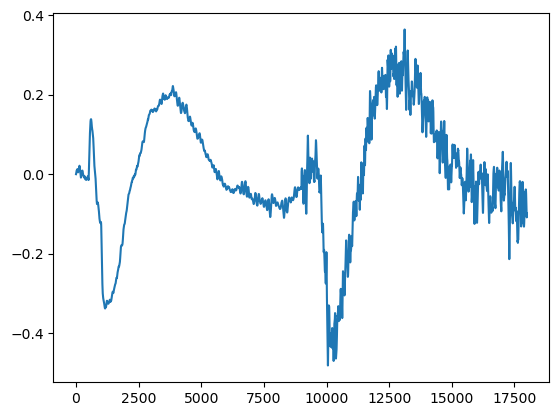

Engineering features from:  010723m1a11kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


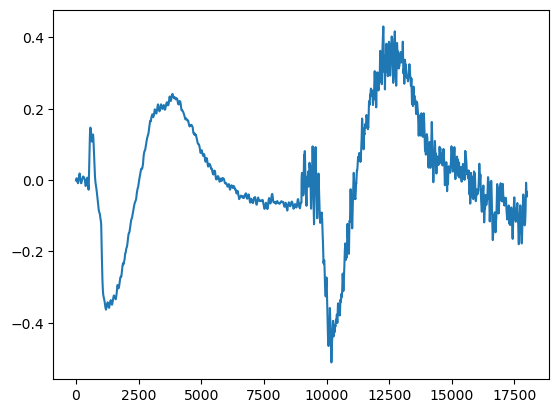

Engineering features from:  010723m1a11kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kbenzaldehyde0001wave1


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kbenzaldehyde0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kbenzylalcohol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
C

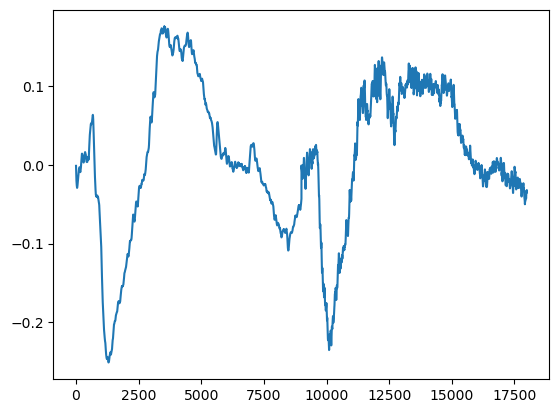

Engineering features from:  010723m1a11kbenzylalcohol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


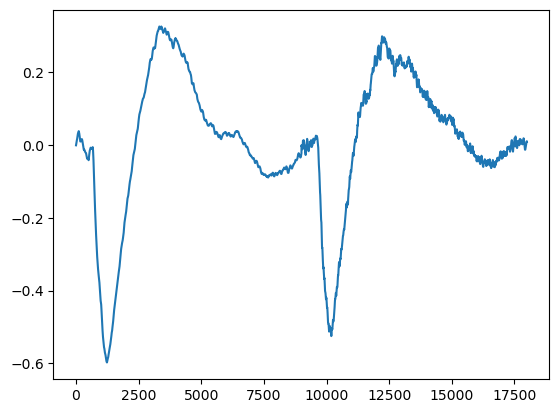

Engineering features from:  010723m1a11kbenzylalcohol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


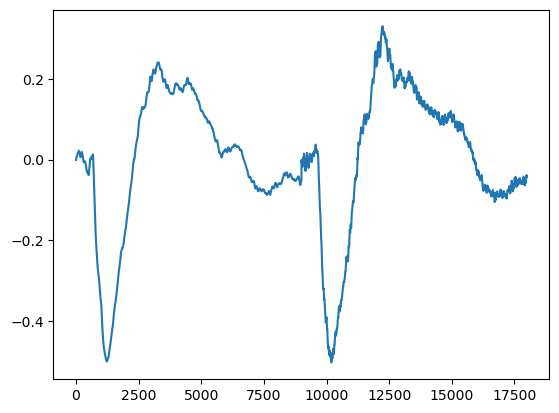

Engineering features from:  010723m1a11klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klemonoil0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


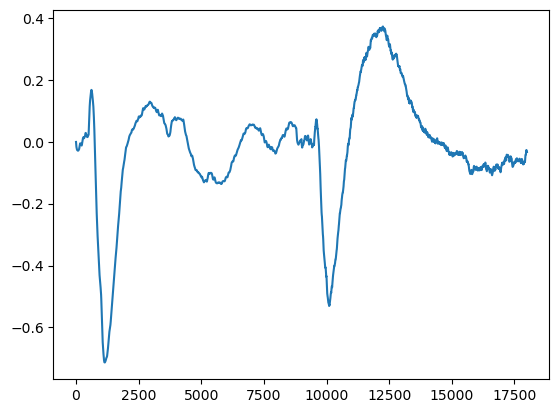

Engineering features from:  010723m1a11klemonoil0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


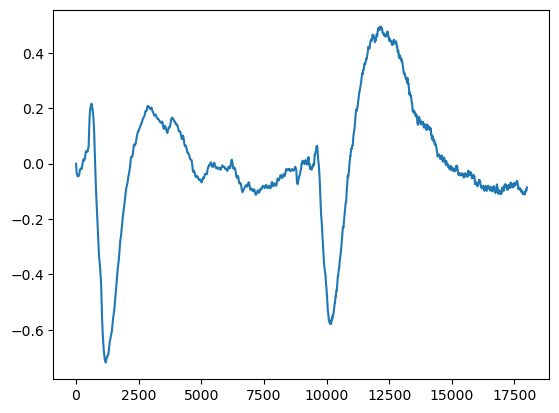

Engineering features from:  010723m1a11klemonoil0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klemonoil0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klemonoil0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


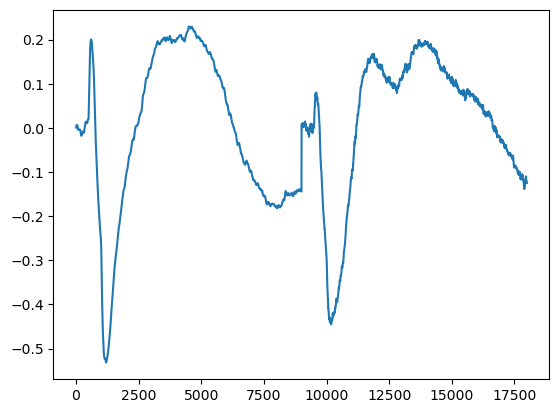

Engineering features from:  010723m1a11klemonoil0002wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klimonene0000wave0


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klimonene0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


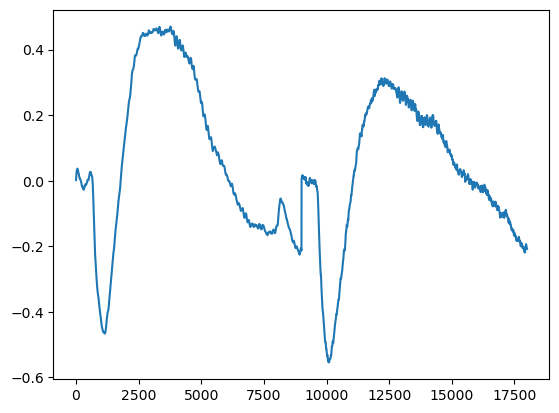

Engineering features from:  010723m1a11klimonene0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klinalool0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11klinalool0000wave1


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


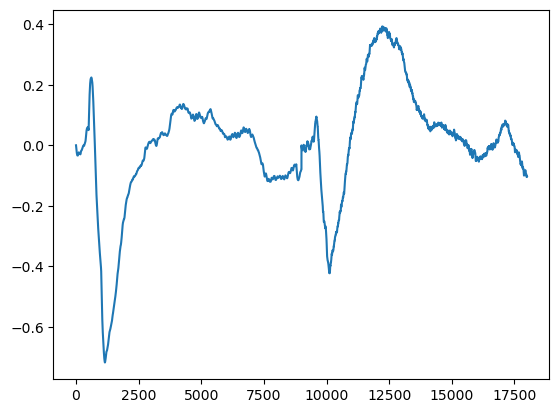

Engineering features from:  010723m1a11klinalool0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


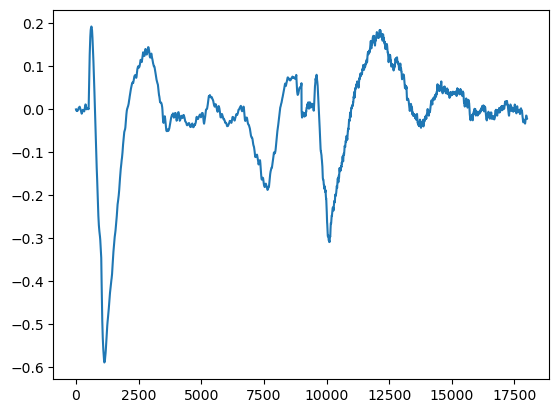

Engineering features from:  010723m1a11klinalool0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


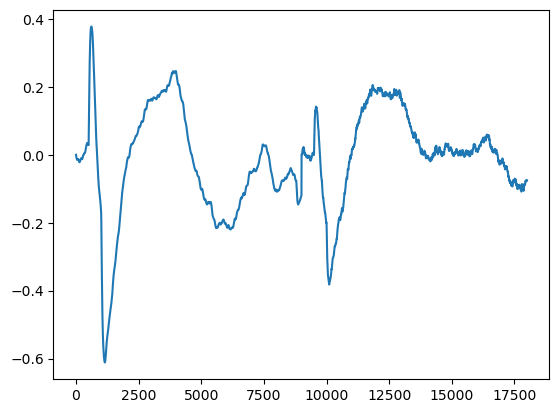

Engineering features from:  010723m1a11klinalool0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


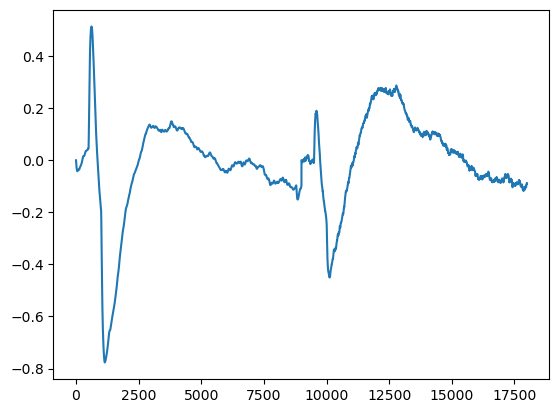

Engineering features from:  010723m1a11klinalool0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


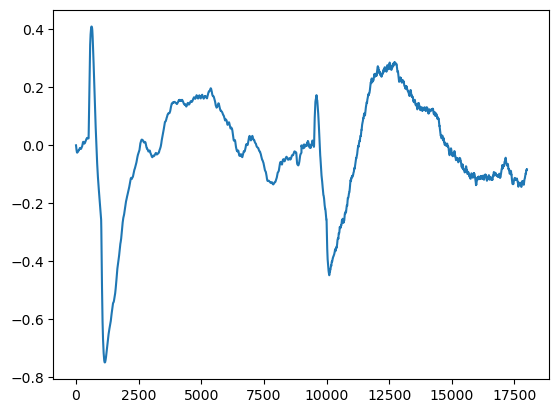

Engineering features from:  010723m1a11kroseoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kroseoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


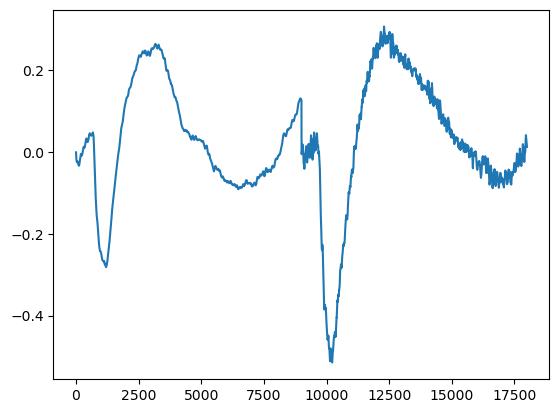

Engineering features from:  010723m1a11kroseoil0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


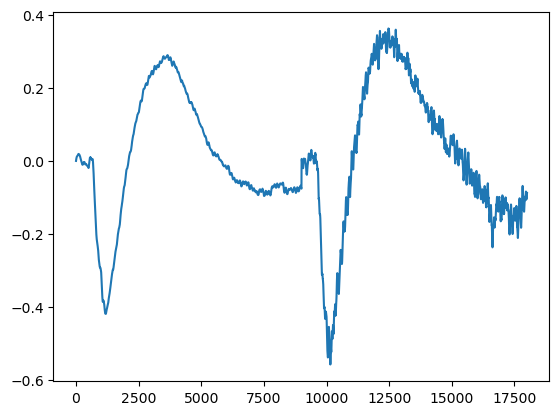

Engineering features from:  010723m1a11kroseoil0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


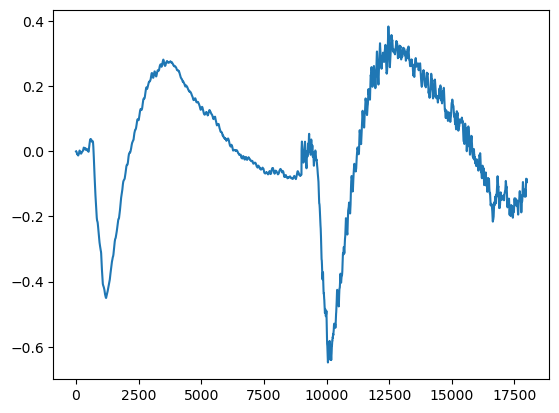

Engineering features from:  010723m1a11kroseoil0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  010723m1a11kylangylang0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


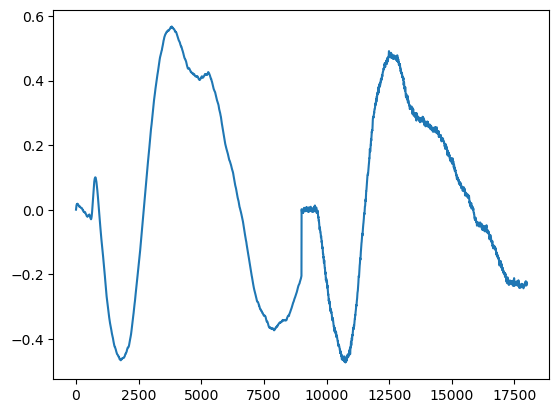

Engineering features from:  010723m1a11kylangylang0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


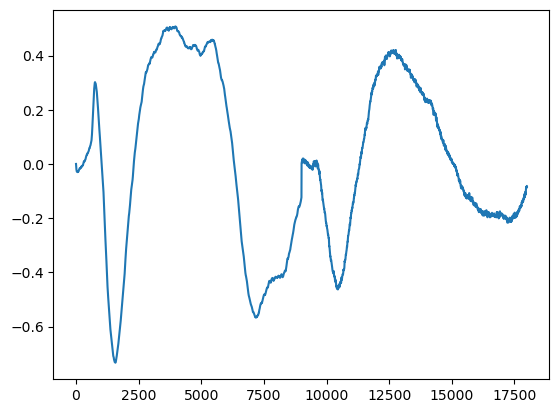

Engineering features from:  011223m2a21k1octen3ol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21k1octen3ol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21k1octen3ol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering

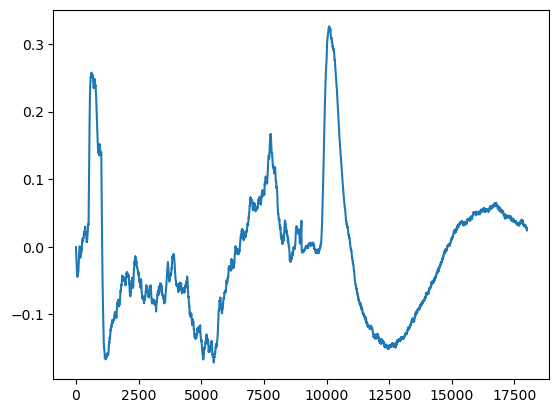

Engineering features from:  011223m2a21kbenzaldehyde0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


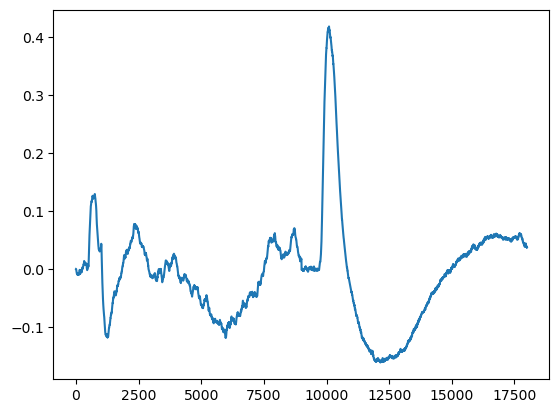

Engineering features from:  011223m2a21kbenzaldehyde0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21kbenzaldehyde0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21kbenzaldehyde0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21kbenzaldehyde0002wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature En

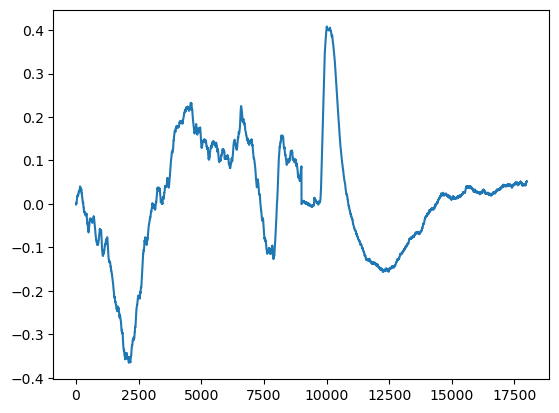

Engineering features from:  011223m2a21klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21klemonoil0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21klemonoil0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011223m2a21klemonoil0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

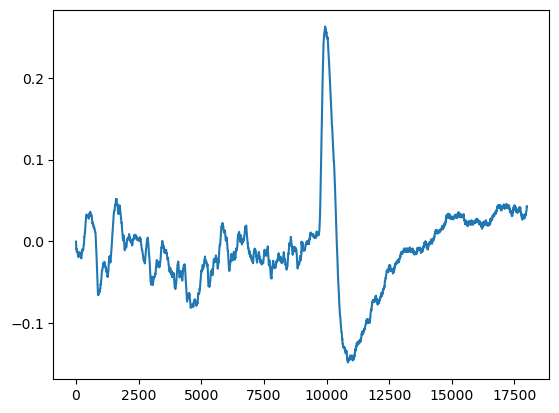

Engineering features from:  011823m1a11k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11k1octen3ol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11k1octen3ol0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering

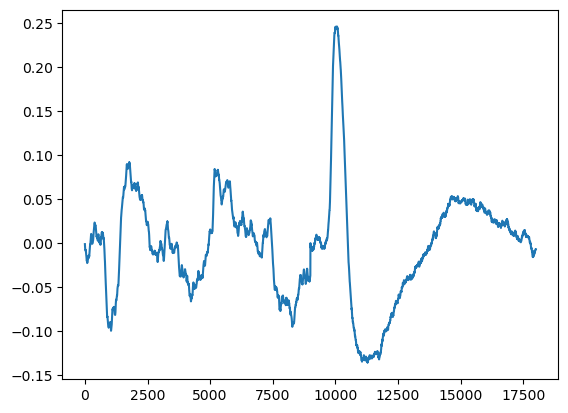

Engineering features from:  011823m1a11kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11kbenzylalcohol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11kbenzylalcohol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a11kbenzylalcohol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Featur

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21k1octen3ol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21k1octen3ol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


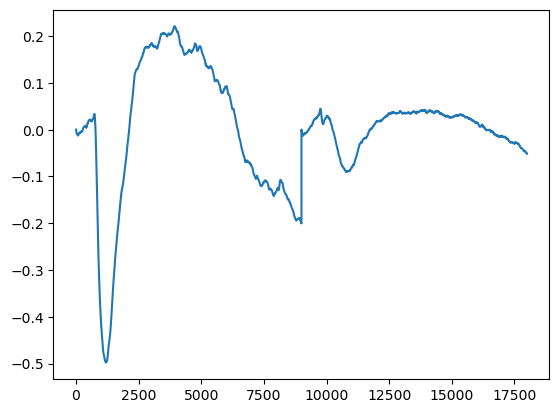

Engineering features from:  011823m1a21k1octen3ol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21k1octen3ol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


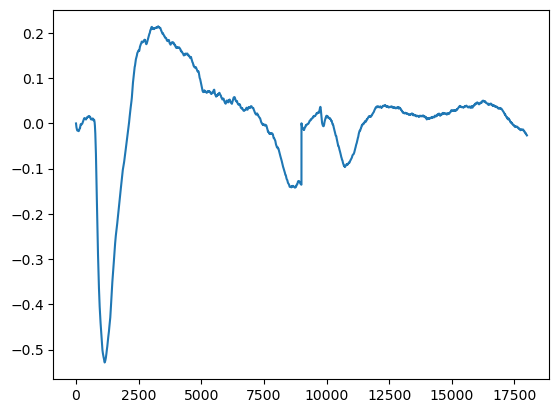

Engineering features from:  011823m1a21kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kbenzaldehyde0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature En

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kroseoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011823m1a21kroseoil0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extractin

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m2a11kbenzylalcohol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m2a11kbenzylalcohol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m2a11klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11klemonoil0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11klinalool0000wave2


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11klinalool0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


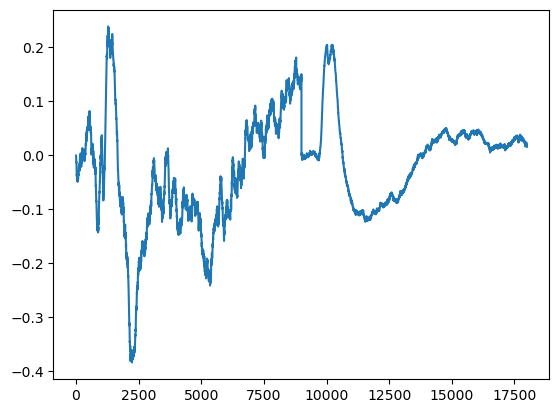

Engineering features from:  011923m3a11kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  011923m3a11kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineerin

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m1a11klinalool0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m1a11klinalool0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m1a11klinalool0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

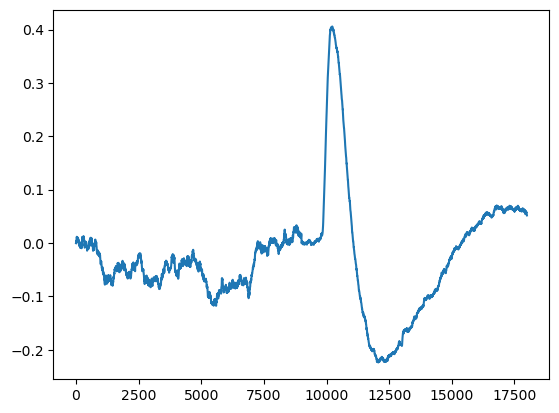

Engineering features from:  012423m2a11kbenzaldehyde0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


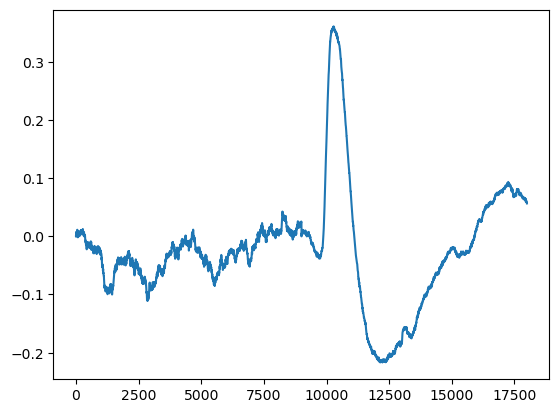

Engineering features from:  012423m2a11kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


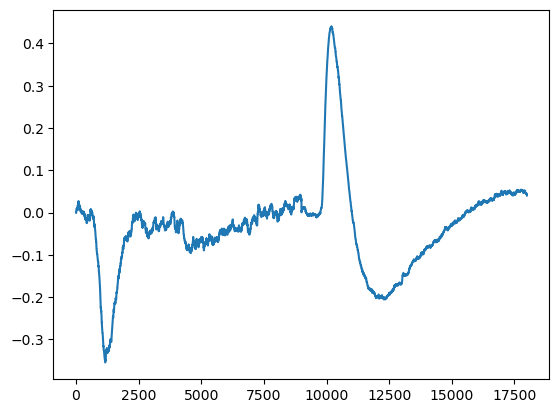

Engineering features from:  012423m2a11kbenzylalcohol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


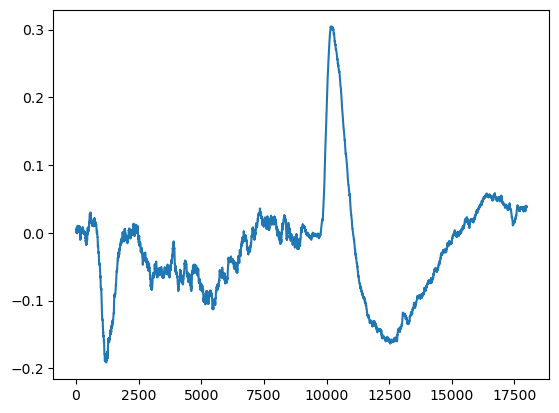

Engineering features from:  012423m2a11kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


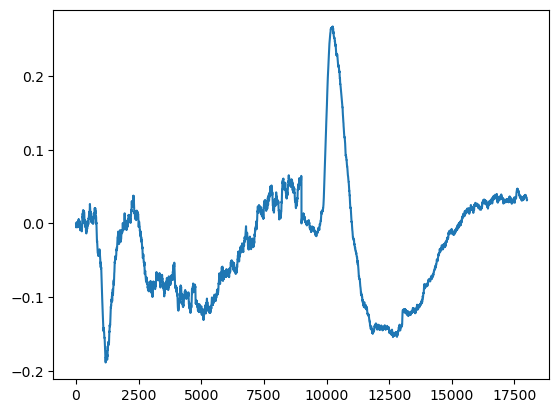

Engineering features from:  012423m2a11kbenzylalcohol0001wave0
Feature Engineering Channel:  1


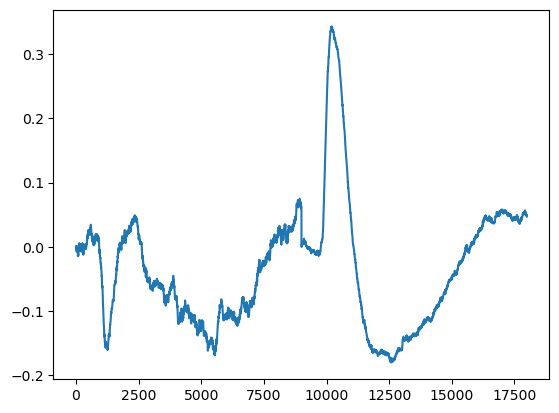

Engineering features from:  012423m2a11kbenzylalcohol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klemonoil0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

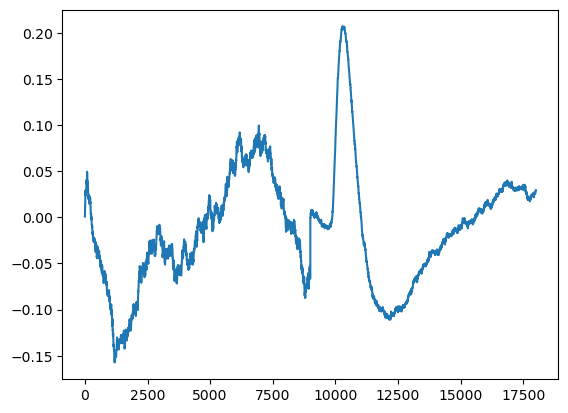

Engineering features from:  012423m2a11klimonene0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klimonene0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klinalool0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a11klinalool0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a21kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a21kbenzylalcohol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m2a21kbenzylalcohol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11k1octen3ol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count:

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11kylangylang0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a11roseoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extr

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a21klinalool0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a21klinalool0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012423m3a21klinalool0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a11k1octen3ol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a11kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a11kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count:

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a21k1octen3ol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a21k1octen3ol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m1a21k1octen3ol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
ext

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11k1octen3ol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11k1octen3ol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
ext

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11klinalool0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11klinalool0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a11klinalool0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a21kbenzylalcohol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a21klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m2a21klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
e

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Cou

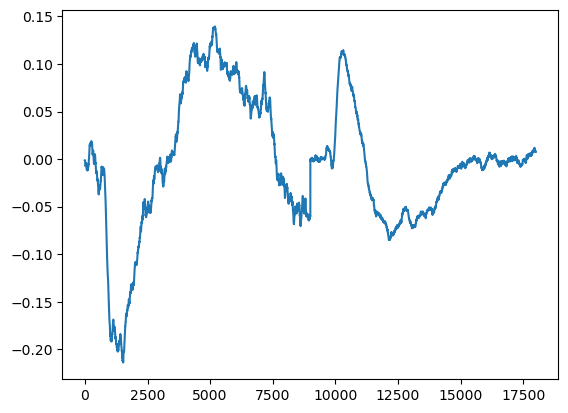

Engineering features from:  012623m3a21kbenzylalcohol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m3a21klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m4a11k1octen3ol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m4a11k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012623m4a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11k1octen3ol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11k1octen3ol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11k1octen3ol0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
ext

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11kroseoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11kroseoil0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m1a11kroseoil0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extractin

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klemonoil0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klemonoil0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klimonene0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


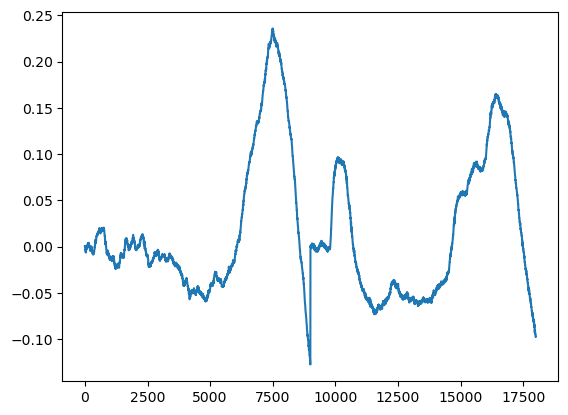

Engineering features from:  012823m2a11klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klimonene0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a11klimonene0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kbenzaldehyde0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kbenzaldehyde0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kbenzaldehyde0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Cou

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kylangylang0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kylangylang0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m2a21kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2


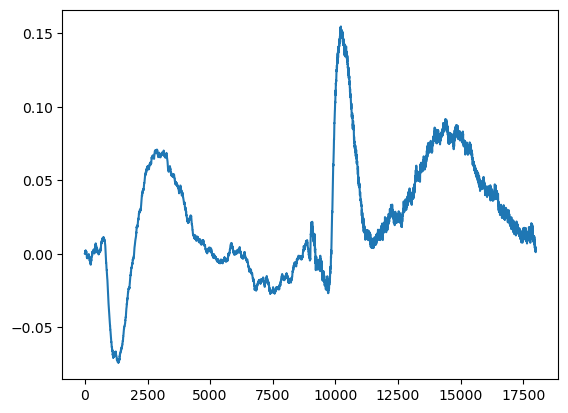

Engineering features from:  012823m3a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a11klimonene0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a11klimonene0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a11klimonene0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a21klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a21klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  012823m3a21klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  020623m1a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  020623m1a11klimonene0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  020623m1a11klimonene0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extrac

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


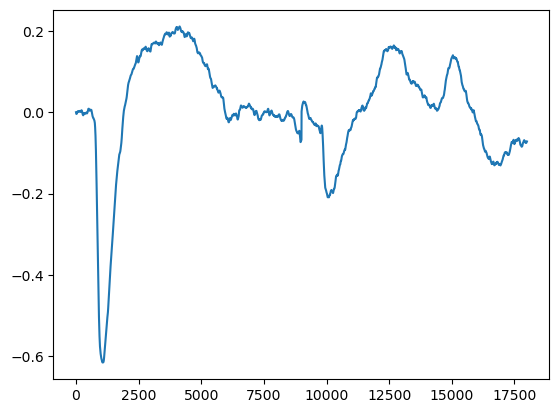

Engineering features from:  020623m1a11kylangylang0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  020623m1a11kylangylang0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  020623m1a11kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m1a11k1octen3ol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering

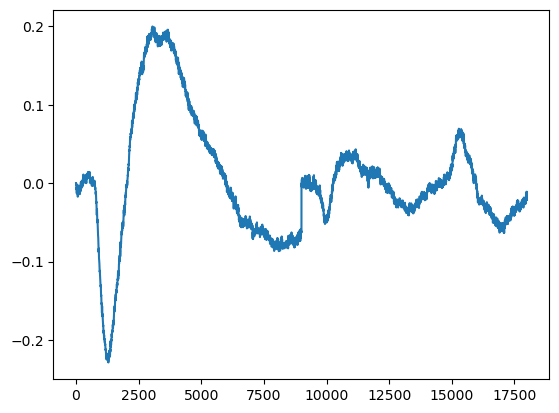

Engineering features from:  032223m1a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m1a11klinalool0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m1a11klinalool0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m1a11klinalool0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channe

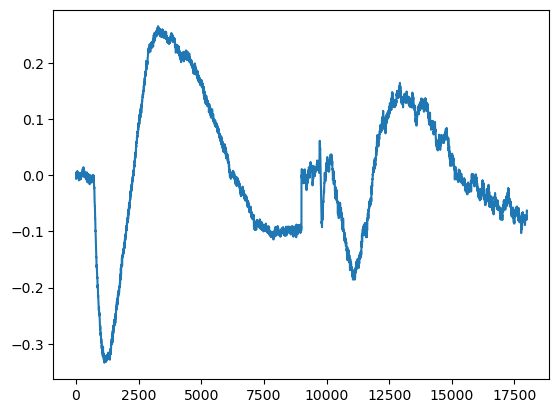

Engineering features from:  032223m2a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kbenzaldehyde0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature E

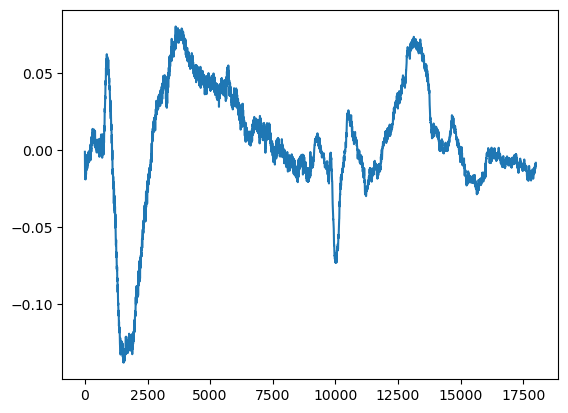

Engineering features from:  032223m2a11kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a11kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

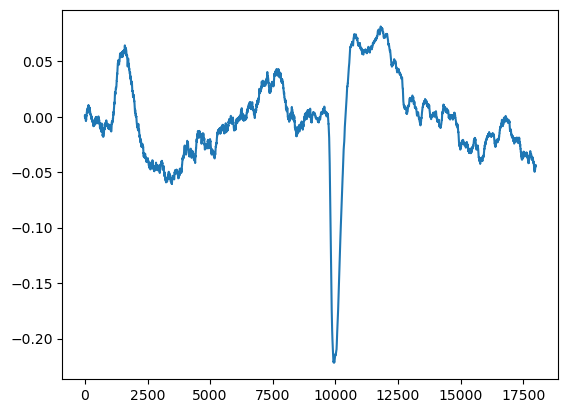

Engineering features from:  032223m2a21kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a21kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a21kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m2a21kylangylang0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

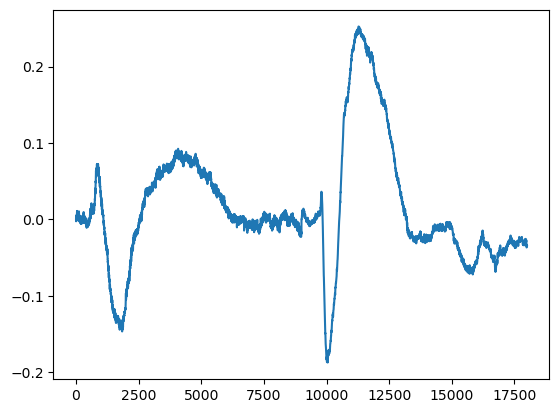

Engineering features from:  032223m3a11klimonene0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


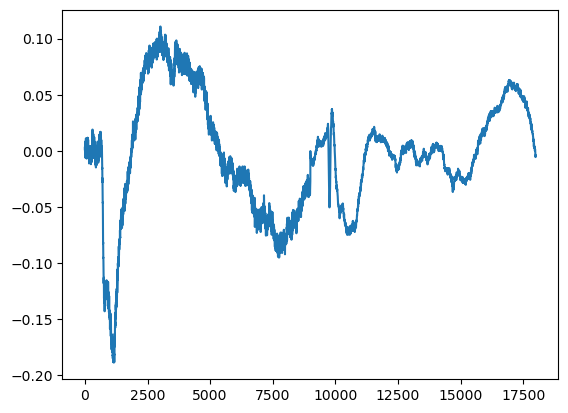

Engineering features from:  032223m3a11klinalool0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


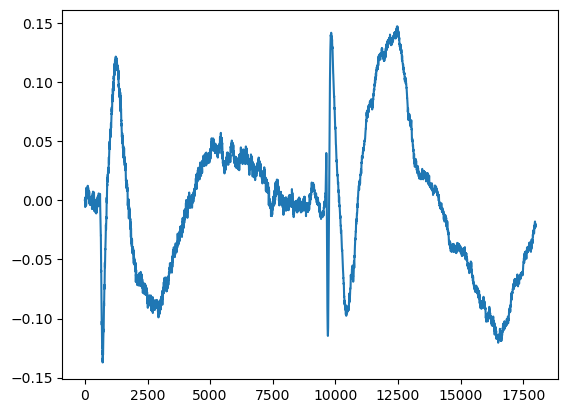

Engineering features from:  032223m3a11klinalool0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


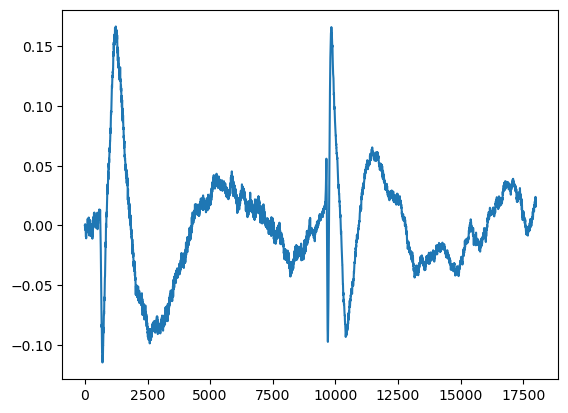

Engineering features from:  032223m3a11kroseoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


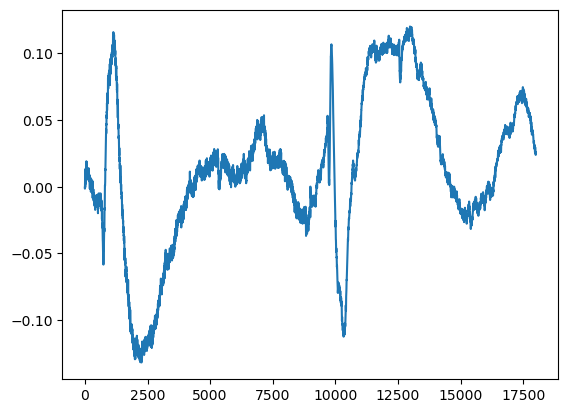

Engineering features from:  032223m3a11kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kroseoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Chan

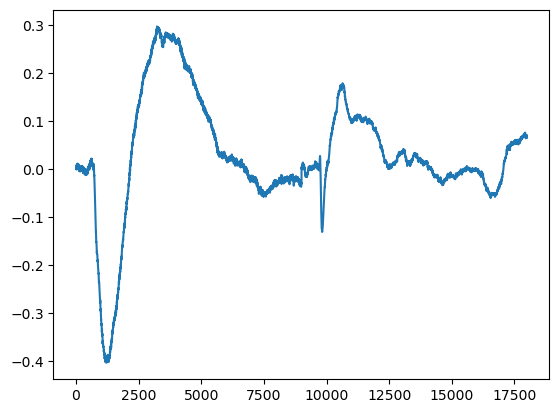

Engineering features from:  032223m3a11kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kylangylang0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kylangylang0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032223m3a11kylangylang0002wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineerin

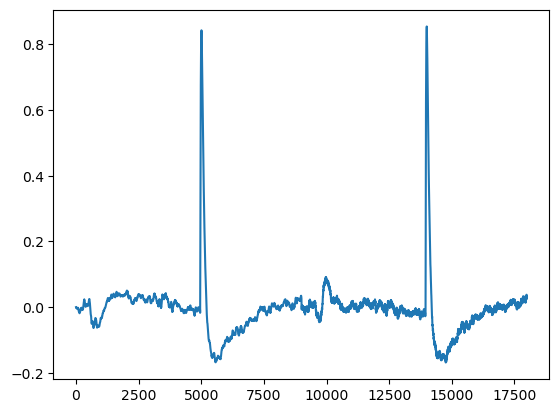

Engineering features from:  032423m1a11kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11k1octen3ol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11kbenzaldehyde0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


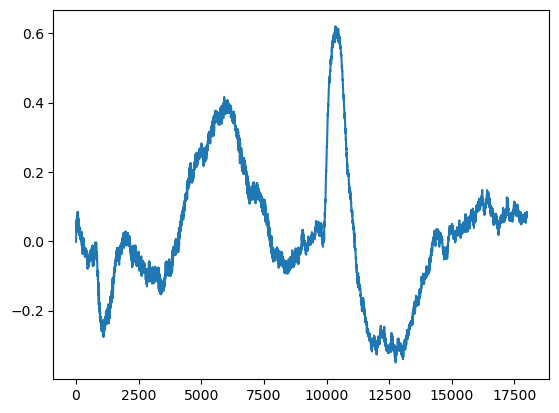

Engineering features from:  032423m2a11kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11kbenzylalcohol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11klinalool0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineer

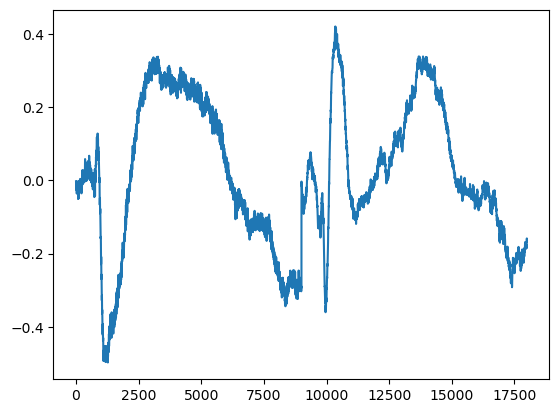

Engineering features from:  032423m2a11kylangylang0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a11kylangylang0002wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineeri

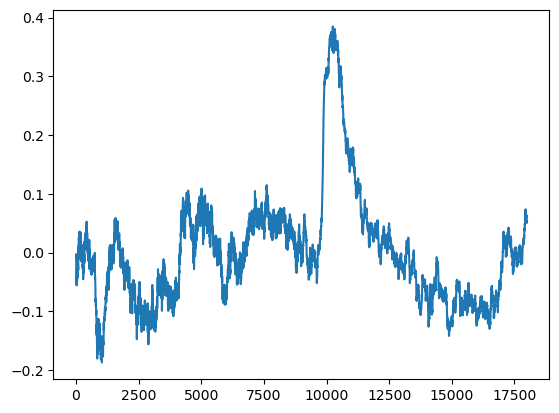

Engineering features from:  032423m2a21klimonene0000wave0
Feature Engineering Channel:  1


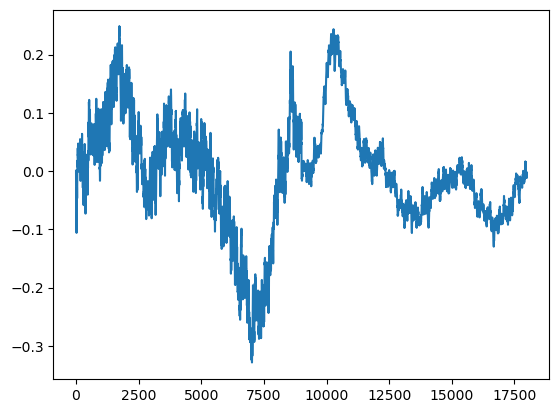

Engineering features from:  032423m2a21kroseoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


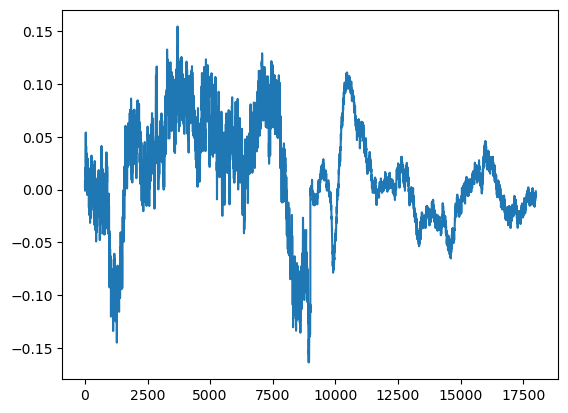

Engineering features from:  032423m2a21kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21kylangylang0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m2a21kylangylang0001wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineerin

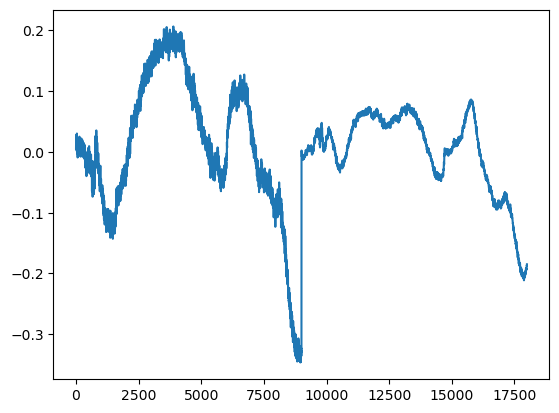

Engineering features from:  032423m3a21kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m3a21kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m3a21kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m3a21kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

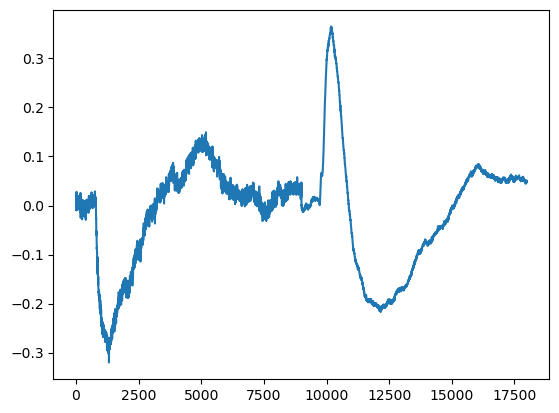

Engineering features from:  032423m4a11kbenzaldehyde0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11kbenzylalcohol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


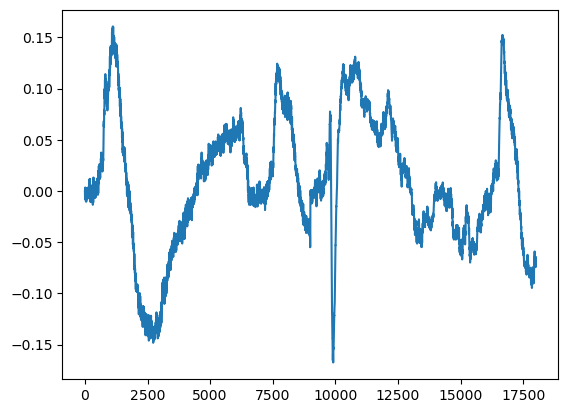

Engineering features from:  032423m4a11kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11klimonene0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering C

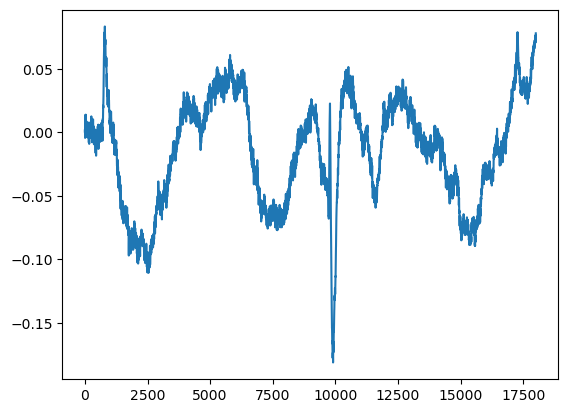

Engineering features from:  032423m4a11klinalool0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11kroseoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Cha

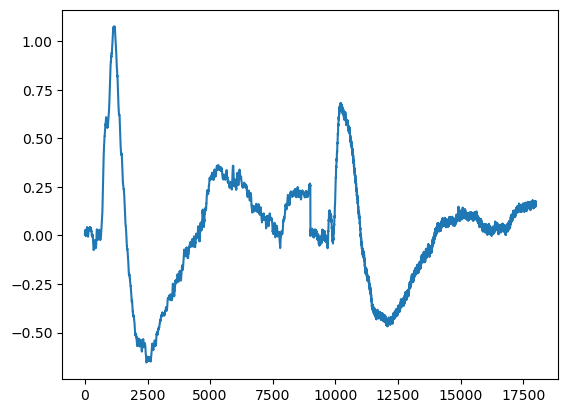

Engineering features from:  032423m4a11kylangylang0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a11kylangylang0002wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


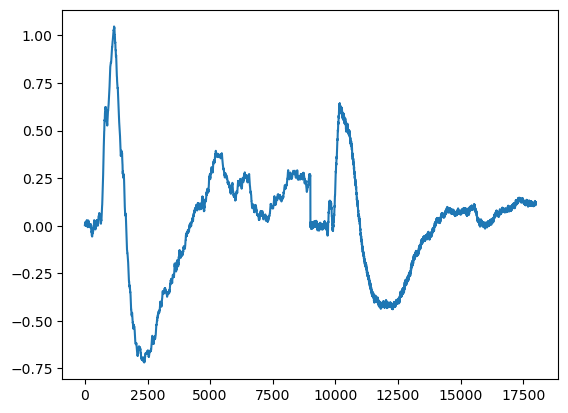

Engineering features from:  032423m4a21k1octen3ol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21k1octen3ol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzaldehyde0000wave1


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzylalcohol0000wave0


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzylalcohol0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzylalcohol0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzylalcohol0001wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


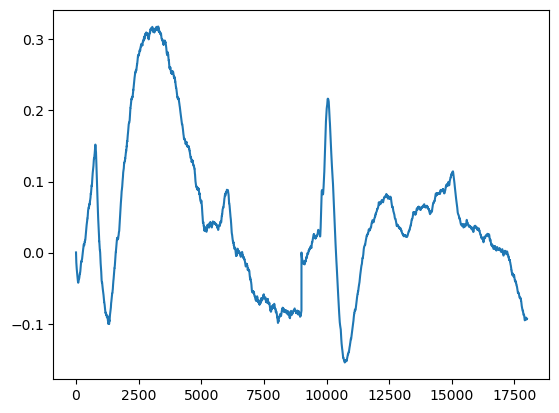

Engineering features from:  032423m4a21kbenzylalcohol0002wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kbenzylalcohol0002wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kroseoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineeri

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  032423m4a21kylangylang0001wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2


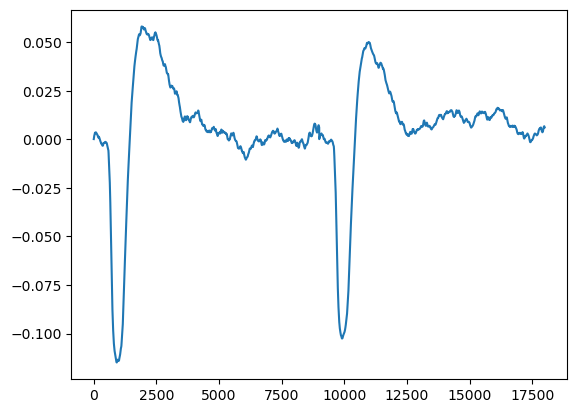

Engineering features from:  111822m1a110klimonene0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a110klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features


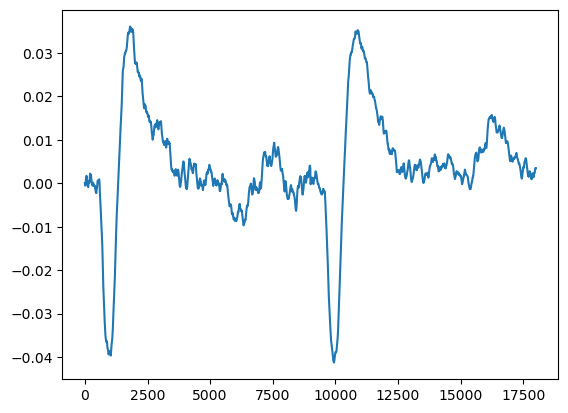

Engineering features from:  111822m1a110klimonene0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


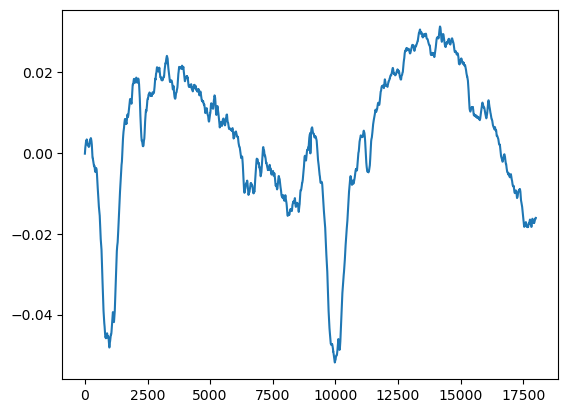

Engineering features from:  111822m1a110kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a110kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11klemonoil0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering 

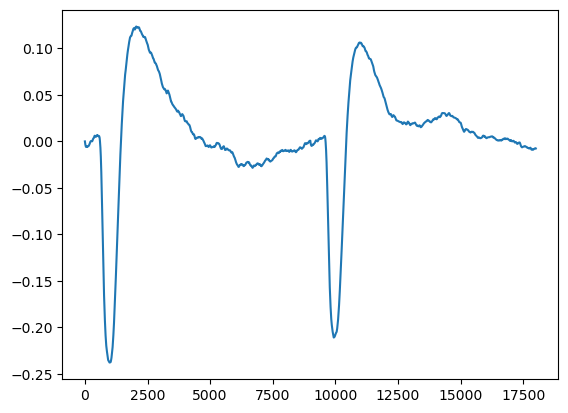

Engineering features from:  111822m1a11klemonoil0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11klimonene0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11klimonene0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11klimonene0000wave2


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


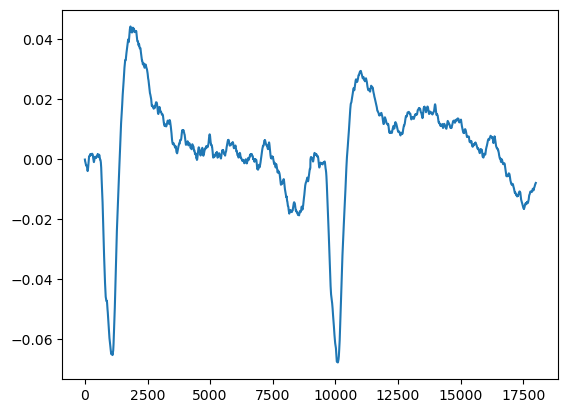

Engineering features from:  111822m1a11kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11kylangylang0000wave1
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m1a11kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a1100ylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineeri

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a110kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2


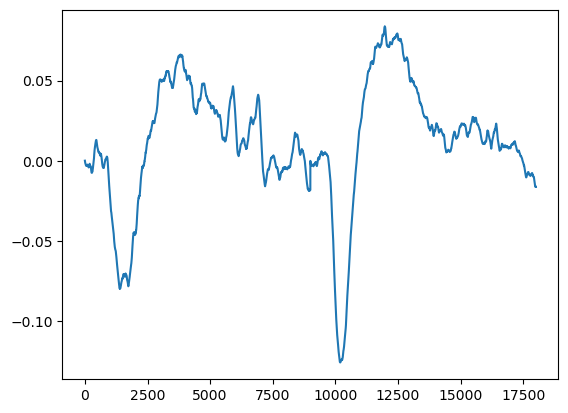

Engineering features from:  111822m2a110klemonoil0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a110kylangylang0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a110kylangylang0000wave1


/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a110kylangylang0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a11kbenzylalcohol0000wave0
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Engineering features from:  111822m2a11kbenzylalcohol0000wave2
Feature Engineering Channel:  1
Count: 1
extracting phase 1 features
Count: 2
extracting phase 2 features
Feature Engineering Channel:  2
Count: 1
extracting phase 1 features
Co

/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:181: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:195: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/joshswore/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_mstats_common.py:198: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC
010723m1a11k1octen3ol0001wave1,1,0.016934,100,106,206,-0.000123,0.000389,2.720475,0.058651,736,970,1706,-0.000051,0.000078,61.628435
010723m1a11kbenzaldehyde0000wave2,283,0.383618,379,850,1229,-0.000433,0.000880,269.615451,0.260993,1413,1544,2957,-0.000161,0.000154,465.187108
010723m1a11kbenzaldehyde0001wave1,278,0.211331,488,801,1289,-0.000152,0.000490,150.741809,0.156832,1701,3192,4893,-0.000037,0.000115,392.288894
010723m1a11kbenzaldehyde0001wave2,216,0.268935,494,766,1260,-0.000252,0.000518,179.827190,0.153246,1036,1763,2799,-0.000072,0.000203,277.963698
010723m1a11kbenzylalcohol0000wave0,329,0.444522,710,871,1581,-0.000464,0.001164,460.385071,0.362992,1116,2543,3659,-0.000118,0.000379,908.164224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111822m2a11kbenzylalcohol0000wave2,517,0.039172,658,661,1319,-0.000049,0.000048,26.761661,0.048578,1412,3148,4560,-0.000007,0.000026,128.000886
111822m2a11klemonoil0000wave2,689,0.075470,1483,63,1546,-0.000773,0.000041,57.806072,0.005637,6,6,12,-0.000925,0.001320,0.043315
111822m2a11kylangylang0000wave0,535,0.556473,561,714,1275,-0.000710,0.001136,429.766452,0.352015,1598,2234,3832,-0.000109,0.000289,886.472525
111822m2a11kylangylang0000wave1,430,0.472430,453,790,1243,-0.000595,0.001385,329.058280,0.238416,1092,2634,3726,-0.000029,0.000307,608.576504


In [13]:
All_df=pd.read_csv('/Users/joshswore/Manduca/MultiChannel/Floral/Quality_Controlled_Data/YY_Normalized/_QC_T_0.751.csv',index_col=0)
CH1_DF=pd.DataFrame()
CH2_DF=pd.DataFrame()
for col in All_df.T.columns:
    print('Engineering features from: ', col)
    try:
        CH1,CH2=FeatureExtracter(All_df.T, col)
        CH1_DF=pd.concat([CH1_DF, pd.DataFrame(CH1,index=[col])])
        CH2_DF=pd.concat([CH2_DF, pd.DataFrame(CH2,index=[col])])
    except:
        All_df.T[col][:-3].plot()
        plt.show()
        
        
        #x=input('Data is too poor to engineer data. Would you like to drop? Yes or No')
        #if x == 'Yes':
        All_df=All_df.drop(index=col)
        #else:
           # pass
CH1_DF

In [213]:
pd.read_csv('/Users/joshswore/Manduca/MultiChannel/Floral/Feature_Engineering/YY_Normalized_Floral_QCd_T065_Features_032823_CH2.csv',index_col=0)

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC
011223m2a21k1octen3ol0000wave0,454,0.314706,300,573,873,-0.000479,0.001302,162.540018,0.082376,1255,3021,4276,-0.000015,0.000039,218.432239
011223m2a21k1octen3ol0000wave1,542,0.358464,230,608,838,-0.000562,0.002198,200.598975,0.143280,1144,2485,3629,-0.000053,0.000168,341.991616
011223m2a21k1octen3ol0000wave2,326,0.411896,325,589,914,-0.000712,0.002135,252.109697,0.188956,1738,1911,3649,-0.000087,0.000089,416.097929
011223m2a21kbenzaldehyde0000wave0,461,0.601527,301,657,958,-0.000952,0.002672,361.840218,0.262628,1628,2225,3853,-0.000102,0.000203,681.584464
011223m2a21kbenzaldehyde0000wave1,271,0.664977,272,713,985,-0.000988,0.002952,409.204165,0.288276,1287,2282,3569,-0.000117,0.000192,611.833426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
032423m4a21kylangylang0000wave1,51,0.087023,359,431,790,-0.000154,0.000236,37.149986,0.131317,573,1902,2475,-0.000058,0.000210,163.220634
032423m4a21kylangylang0000wave2,277,0.135567,353,378,731,-0.000345,0.000271,65.783210,0.098734,493,1984,2477,-0.000029,0.000196,158.198596
032423m4a21kylangylang0001wave0,428,0.455982,203,409,612,-0.001037,0.002683,181.226501,0.327732,512,1128,1640,-0.000263,0.000858,353.971009
032423m4a21kylangylang0001wave1,383,0.438745,314,297,611,-0.001377,0.001562,144.770440,0.479395,399,1080,1479,-0.000418,0.001427,443.458136


In [12]:
All_df.iloc[:,-3:]
CH1_DF

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,...,111822m2a110kylangylang0000wave2,111822m2a11kbenzylalcohol0000wave0,111822m2a11kbenzylalcohol0000wave2,111822m2a11klemonoil0000wave2,111822m2a11kylangylang0000wave0,111822m2a11kylangylang0000wave1,111822m2a11kylangylang0000wave2,label,concentration,date
010723m1a11k1octen3ol0001wave1,1.0,0.016934,100.0,106.0,206.0,-0.000123,0.000389,2.720475,0.058651,736.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
010723m1a11kbenzaldehyde0000wave2,283.0,0.383618,379.0,850.0,1229.0,-0.000433,0.000880,269.615451,0.260993,1413.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
010723m1a11kbenzaldehyde0001wave1,278.0,0.211331,488.0,801.0,1289.0,-0.000152,0.000490,150.741809,0.156832,1701.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
010723m1a11kbenzaldehyde0001wave2,216.0,0.268935,494.0,766.0,1260.0,-0.000252,0.000518,179.827190,0.153246,1036.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
010723m1a11kbenzylalcohol0000wave0,329.0,0.444522,710.0,871.0,1581.0,-0.000464,0.001164,460.385071,0.362992,1116.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111822m2a11kbenzylalcohol0000wave2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,benzylalcohol,1k,111822m2a1
111822m2a11klemonoil0000wave2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,lemonoil,1k,111822m2a1
111822m2a11kylangylang0000wave0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ylangylang,1k,111822m2a1
111822m2a11kylangylang0000wave1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ylangylang,1k,111822m2a1


In [14]:

pd.concat([CH1_DF,All_df.iloc[:,-3:]],axis=1)

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC,label,concentration,date
010723m1a11k1octen3ol0001wave1,1,0.016934,100,106,206,-0.000123,0.000389,2.720475,0.058651,736,970,1706,-0.000051,0.000078,61.628435,1octen3ol,1k,010723m1a1
010723m1a11kbenzaldehyde0000wave2,283,0.383618,379,850,1229,-0.000433,0.000880,269.615451,0.260993,1413,1544,2957,-0.000161,0.000154,465.187108,benzaldehyde,1k,010723m1a1
010723m1a11kbenzaldehyde0001wave1,278,0.211331,488,801,1289,-0.000152,0.000490,150.741809,0.156832,1701,3192,4893,-0.000037,0.000115,392.288894,benzaldehyde,1k,010723m1a1
010723m1a11kbenzaldehyde0001wave2,216,0.268935,494,766,1260,-0.000252,0.000518,179.827190,0.153246,1036,1763,2799,-0.000072,0.000203,277.963698,benzaldehyde,1k,010723m1a1
010723m1a11kbenzylalcohol0000wave0,329,0.444522,710,871,1581,-0.000464,0.001164,460.385071,0.362992,1116,2543,3659,-0.000118,0.000379,908.164224,benzylalcohol,1k,010723m1a1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111822m2a11kbenzylalcohol0000wave2,517,0.039172,658,661,1319,-0.000049,0.000048,26.761661,0.048578,1412,3148,4560,-0.000007,0.000026,128.000886,benzylalcohol,1k,111822m2a1
111822m2a11klemonoil0000wave2,689,0.075470,1483,63,1546,-0.000773,0.000041,57.806072,0.005637,6,6,12,-0.000925,0.001320,0.043315,lemonoil,1k,111822m2a1
111822m2a11kylangylang0000wave0,535,0.556473,561,714,1275,-0.000710,0.001136,429.766452,0.352015,1598,2234,3832,-0.000109,0.000289,886.472525,ylangylang,1k,111822m2a1
111822m2a11kylangylang0000wave1,430,0.472430,453,790,1243,-0.000595,0.001385,329.058280,0.238416,1092,2634,3726,-0.000029,0.000307,608.576504,ylangylang,1k,111822m2a1


In [15]:
All_df.shape,CH1_DF.shape,CH2_DF.shape
CH1_DF=pd.concat([CH1_DF,All_df.iloc[:,-3:]],axis=1)
CH2_DF=pd.concat([CH2_DF,All_df.iloc[:,-3:]],axis=1)
CH1_DF

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC,label,concentration,date
010723m1a11k1octen3ol0001wave1,1,0.016934,100,106,206,-0.000123,0.000389,2.720475,0.058651,736,970,1706,-0.000051,0.000078,61.628435,1octen3ol,1k,010723m1a1
010723m1a11kbenzaldehyde0000wave2,283,0.383618,379,850,1229,-0.000433,0.000880,269.615451,0.260993,1413,1544,2957,-0.000161,0.000154,465.187108,benzaldehyde,1k,010723m1a1
010723m1a11kbenzaldehyde0001wave1,278,0.211331,488,801,1289,-0.000152,0.000490,150.741809,0.156832,1701,3192,4893,-0.000037,0.000115,392.288894,benzaldehyde,1k,010723m1a1
010723m1a11kbenzaldehyde0001wave2,216,0.268935,494,766,1260,-0.000252,0.000518,179.827190,0.153246,1036,1763,2799,-0.000072,0.000203,277.963698,benzaldehyde,1k,010723m1a1
010723m1a11kbenzylalcohol0000wave0,329,0.444522,710,871,1581,-0.000464,0.001164,460.385071,0.362992,1116,2543,3659,-0.000118,0.000379,908.164224,benzylalcohol,1k,010723m1a1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111822m2a11kbenzylalcohol0000wave2,517,0.039172,658,661,1319,-0.000049,0.000048,26.761661,0.048578,1412,3148,4560,-0.000007,0.000026,128.000886,benzylalcohol,1k,111822m2a1
111822m2a11klemonoil0000wave2,689,0.075470,1483,63,1546,-0.000773,0.000041,57.806072,0.005637,6,6,12,-0.000925,0.001320,0.043315,lemonoil,1k,111822m2a1
111822m2a11kylangylang0000wave0,535,0.556473,561,714,1275,-0.000710,0.001136,429.766452,0.352015,1598,2234,3832,-0.000109,0.000289,886.472525,ylangylang,1k,111822m2a1
111822m2a11kylangylang0000wave1,430,0.472430,453,790,1243,-0.000595,0.001385,329.058280,0.238416,1092,2634,3726,-0.000029,0.000307,608.576504,ylangylang,1k,111822m2a1


In [16]:
CH1_Mean=CH1_DF.groupby(['label']).mean()
CH2_Mean=CH2_DF.groupby(['label']).mean()
#plt.bar(testdf.index,testdf['Phase2 Intensity'])
CH1_Mean

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC
label,,,,,,,,,,,,,,,
1octen3ol,338.636364,0.264165,463.595041,757.272727,1220.867769,-0.000337,0.000823,201.185301,0.188979,1178.619835,1889.181818,3067.801653,-0.000116,0.000300,358.654444
benzaldehyde,348.795276,0.255002,615.251969,780.913386,1396.165354,-0.000306,0.000523,220.603837,0.181091,1233.433071,1927.212598,3160.645669,-0.000101,0.000179,365.302946
benzylalcohol,357.073770,0.249053,601.672131,810.516393,1412.188525,-0.000285,0.000547,213.731356,0.147482,1264.311475,1876.819672,3141.131148,-0.000166,0.000158,305.902526
lemonoil,351.191489,0.271818,577.198582,701.475177,1278.673759,-0.000356,0.000603,219.761142,0.181156,1016.375887,2040.368794,3056.744681,-0.000140,0.000239,368.747020
limonene,335.702703,0.179782,586.099099,698.216216,1284.315315,-0.000241,0.000399,145.632582,0.131968,1027.081081,1660.387387,2687.468468,-0.000097,0.000188,248.109640
linalool,339.982906,0.268504,495.358974,767.307692,1262.666667,-0.000332,0.000779,214.685270,0.169277,1213.188034,1923.521368,3136.709402,-0.000097,0.000180,341.625586
roseoil,359.851852,0.224808,530.824074,636.203704,1167.027778,-0.000333,0.000622,168.780409,0.135292,1134.481481,1671.194444,2805.675926,-0.000188,0.000204,259.114936
ylangylang,377.507389,0.475651,485.349754,776.546798,1261.896552,-0.000606,0.001545,370.169927,0.297614,1185.359606,2135.443350,3320.802956,-0.000208,0.000359,619.363441


In [40]:
CH2_DF[['Response Delay','Phase1 Intensity','label']]

,Response Delay,Phase1 Intensity,label
011223m2a21k1octen3ol0000wave0,454,0.314706,1octen3ol
011223m2a21k1octen3ol0000wave1,542,0.358464,1octen3ol
011223m2a21k1octen3ol0000wave2,326,0.411896,1octen3ol
011223m2a21kbenzaldehyde0000wave0,461,0.601527,benzaldehyde
011223m2a21kbenzaldehyde0000wave1,271,0.664977,benzaldehyde
...,...,...,...
032423m4a21kylangylang0000wave1,51,0.087023,ylangylang
032423m4a21kylangylang0000wave2,277,0.135567,ylangylang
032423m4a21kylangylang0001wave0,428,0.455982,ylangylang
032423m4a21kylangylang0001wave1,383,0.438745,ylangylang


In [41]:
list(zip(targets,colors))

NameError: name 'targets' is not defined

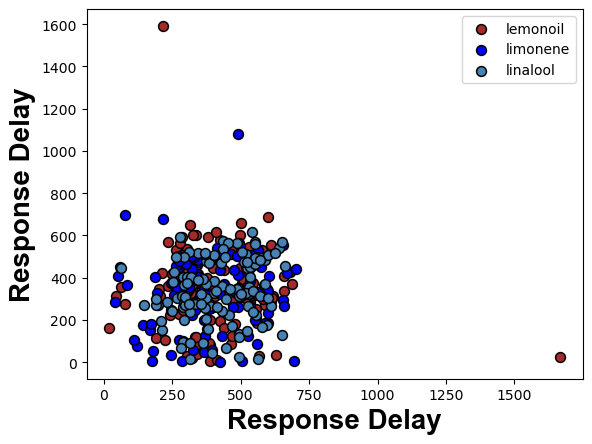

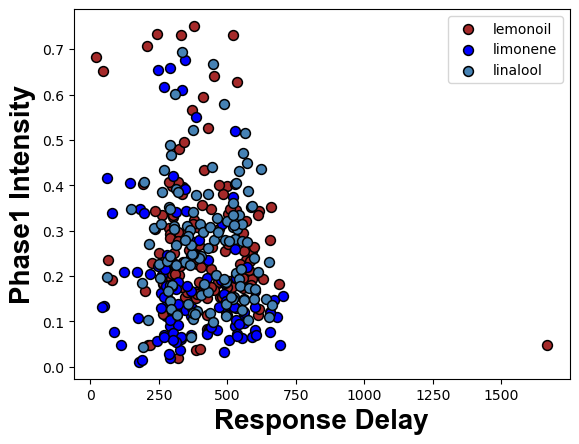

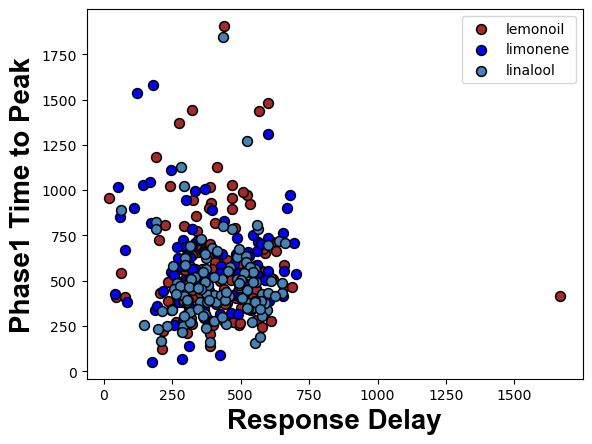

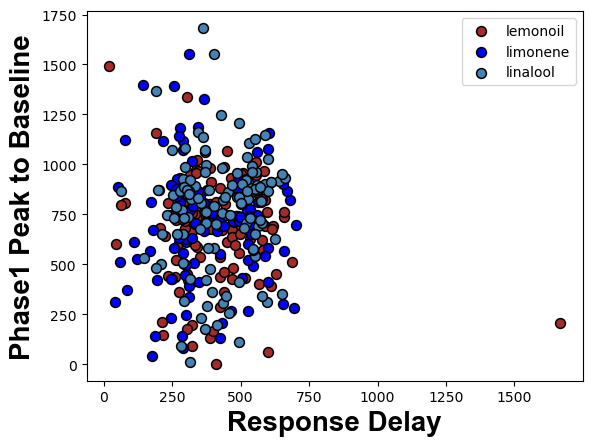

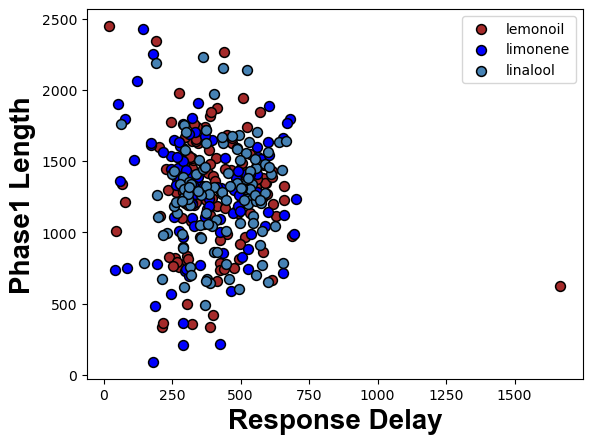

...

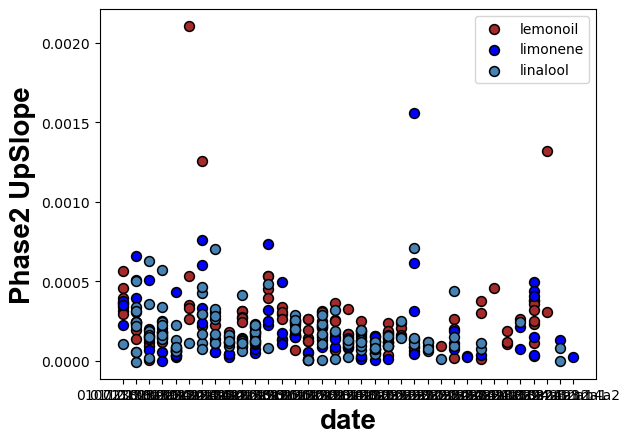

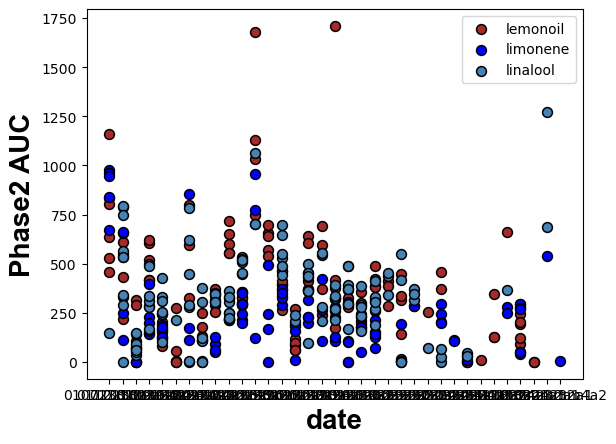

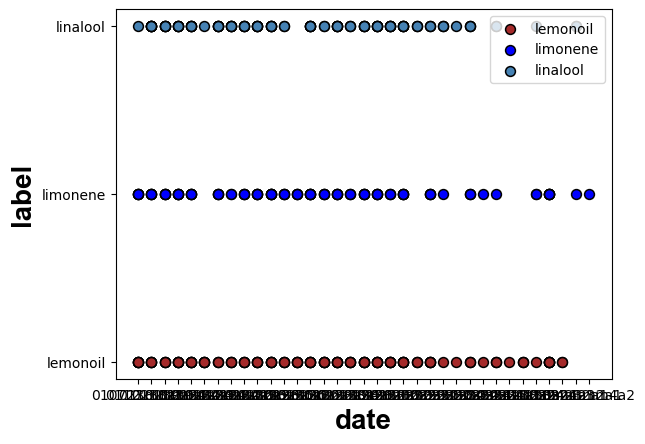

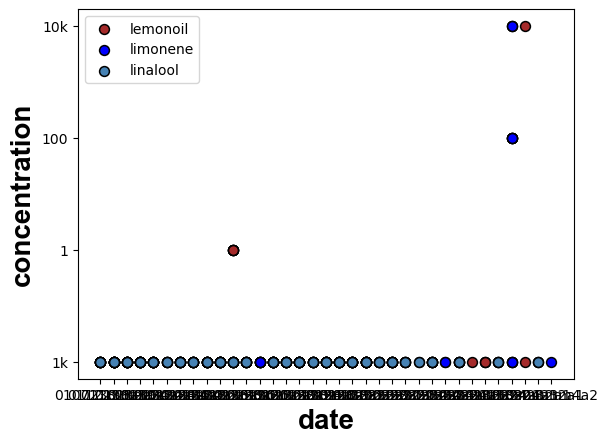

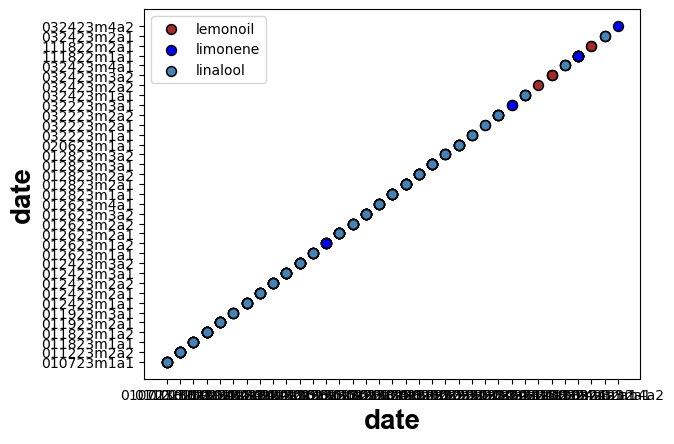

In [17]:
from itertools import product
All_Col_combos=product(CH1_DF.columns,CH1_DF.columns)


#fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
#axes = axes.flat

#Targets = list((CH2_DF['label'].unique()))
Targets = ['lemonoil','limonene','linalool']
targets= Targets
colors = colors = ['brown','blue','steelblue','green','lightgreen','magenta','pink','orange']
for x,y in All_Col_combos:
    for target, color in zip(targets,colors):
        V1=x
        V2=y
        indicesToKeep = (CH2_DF['label']) == target#+data_df['concentration']) == target
        plt.scatter(CH2_DF.loc[indicesToKeep, V1],
                CH1_DF.loc[indicesToKeep, V2], 
                c = color, edgecolors='black', linewidth=1.1, label=target, s = 50)

        plt.xlabel(V1,fontsize=20,weight='bold',fontname='Arial')
        plt.ylabel(V2,fontsize=20,weight='bold',fontname='Arial')
        L = plt.legend()
        plt.setp(L.texts, family='Arial')
        plt.legend(targets, fontsize=10)
    plt.show()

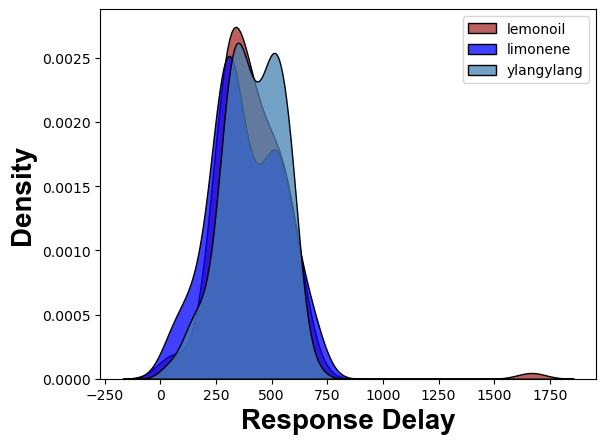

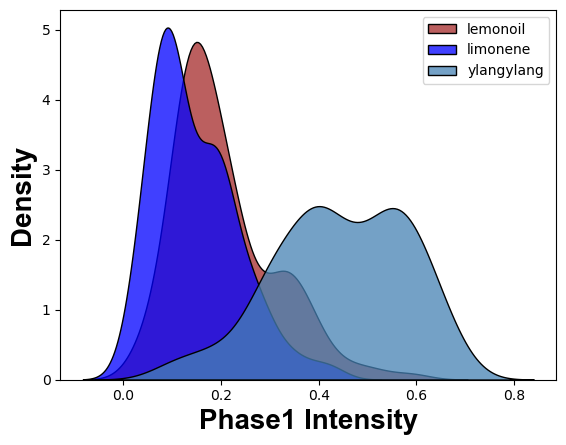

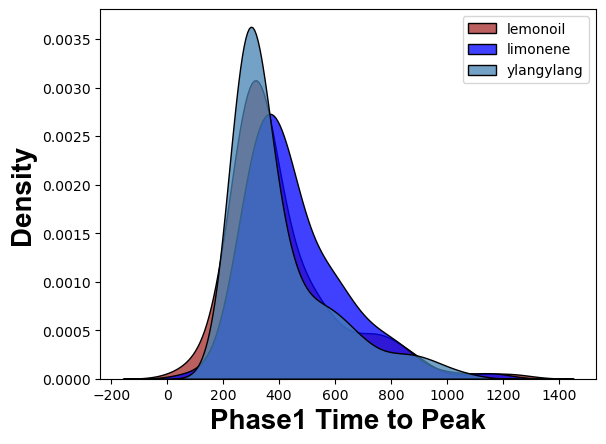

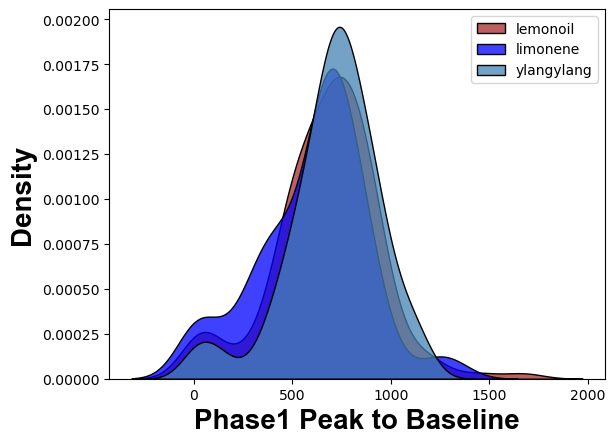

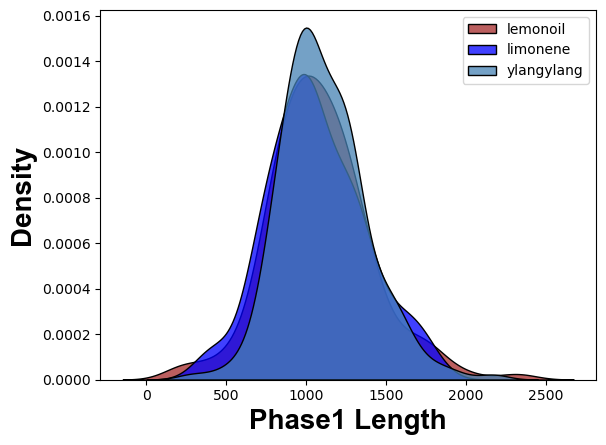

...

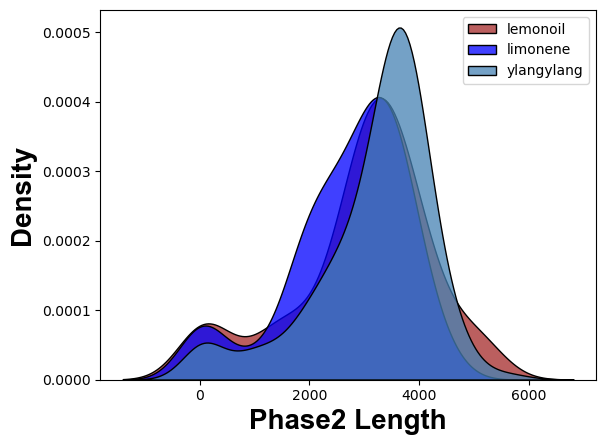

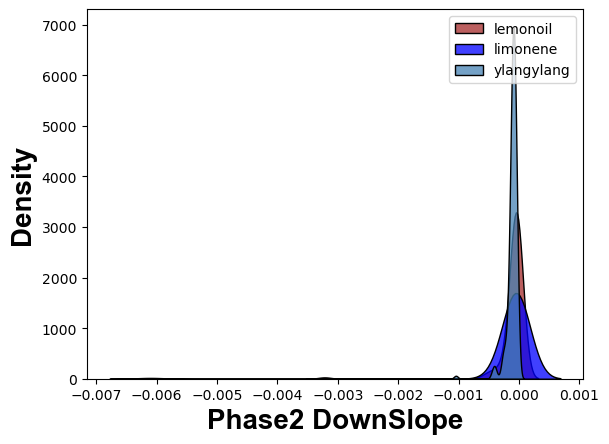

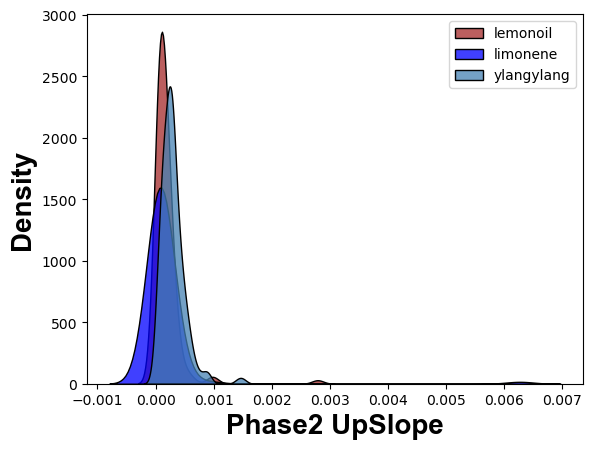

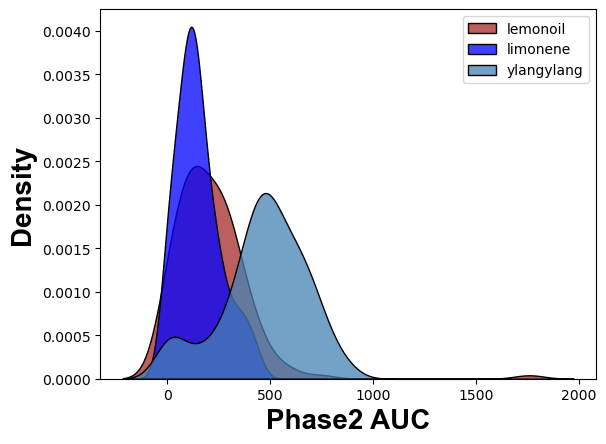

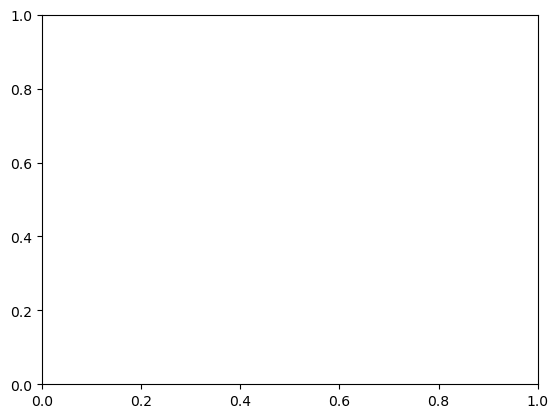

In [19]:
from itertools import product
All_Col_combos=product(CH1_DF.columns,CH1_DF.columns)


#fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
#axes = axes.flat

#Targets = list((CH2_DF['label'].unique()))
Targets = ['lemonoil','limonene','ylangylang']
targets= Targets
colors = colors = ['brown','blue','steelblue','green','lightgreen','magenta','pink','orange']
for x in CH2_DF.columns:
    try:
        for target, color in zip(targets,colors):
            V1=x
            indicesToKeep = (CH2_DF['label']) == target#+data_df['concentration']) == target
            sns.kdeplot(CH2_DF.loc[indicesToKeep, V1],
                     color=color,multiple='stack', label=target)

            #sns.distplot(CH2_DF['Phase1 Intensity'][CH2_DF['label']=='roseoil'], hist = False, kde = True,
                     #kde_kws = {'shade': True, 'linewidth': 1, 'color':'red'}, 
                  #label = 'roseoil')
            
            plt.xlabel(V1,fontsize=20,weight='bold',fontname='Arial')
            plt.ylabel('Density',fontsize=20,weight='bold',fontname='Arial')
            L = plt.legend()
            plt.setp(L.texts, family='Arial')
            plt.legend(targets, fontsize=10)
        plt.show()
    except:
        pass

In [106]:
CH1_Mean

,Response Delay,Phase1 Intensity,Phase1 Time to Peak,Phase1 Peak to Baseline,Phase1 Length,Phase1 DownSlope,Phase1 UpSlope,Phase1 AUC,Phase2 Intensity,Phase2 Time to Peak,Phase2 Peak to Baseline,Phase2 Length,Phase2 DownSlope,Phase2 UpSlope,Phase2 AUC
label,,,,,,,,,,,,,,,
1octen3ol,344.119658,0.153229,465.803419,759.914530,1225.717949,-0.000197,0.000462,116.800710,0.108994,1189.145299,1910.188034,3099.333333,-0.000076,0.000215,205.002540
benzaldehyde,351.239669,0.153652,612.471074,782.206612,1394.677686,-0.000190,0.000345,131.852643,0.113715,1229.694215,1936.884298,3166.578512,-0.000054,0.000109,234.712791
benzylalcohol,359.672566,0.150173,602.530973,820.548673,1423.079646,-0.000172,0.000363,126.769535,0.095912,1242.274336,1882.884956,3125.159292,-0.000095,0.000101,205.435545
lemonoil,334.081818,0.136775,581.663636,739.818182,1321.481818,-0.000167,0.000322,114.472931,0.101735,1101.672727,2113.718182,3215.390909,-0.000055,0.000110,209.976998
limonene,340.142857,0.084663,620.208791,707.340659,1327.549451,-0.000108,0.000174,67.899346,0.066215,1019.934066,1547.582418,2567.516484,-0.000054,0.000087,120.822223
linalool,343.436364,0.163606,498.772727,773.036364,1271.809091,-0.000203,0.000466,134.017764,0.105257,1200.400000,1937.363636,3137.763636,-0.000055,0.000104,226.348850
roseoil,356.311111,0.112779,536.833333,640.255556,1177.088889,-0.000164,0.000306,83.863462,0.065250,1150.844444,1678.211111,2829.055556,-0.000104,0.000097,126.441211
ylangylang,383.552326,0.345857,494.052326,793.401163,1287.453488,-0.000431,0.001143,267.349889,0.213406,1198.965116,2214.267442,3413.232558,-0.000138,0.000233,455.573546


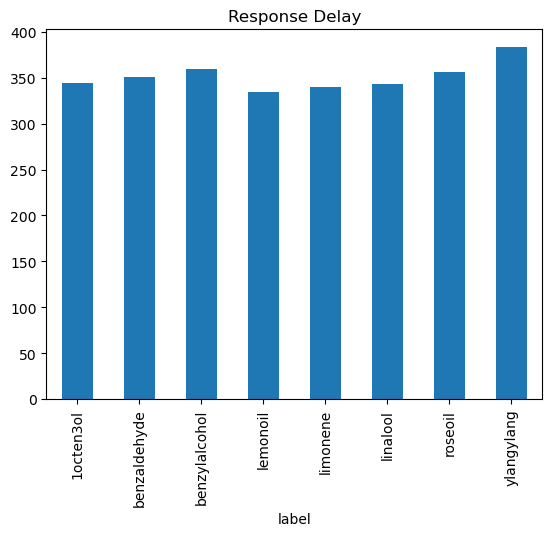

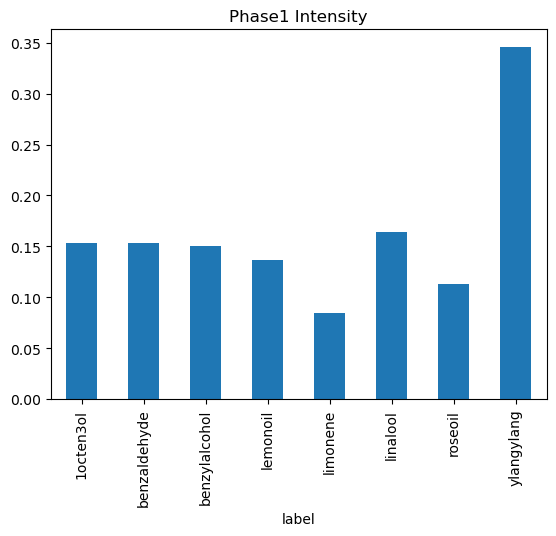

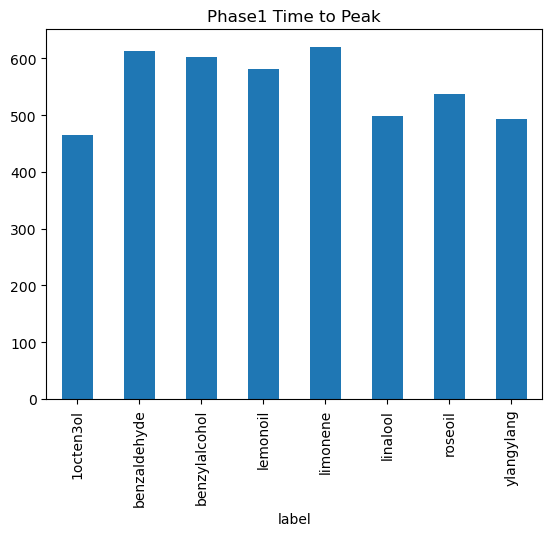

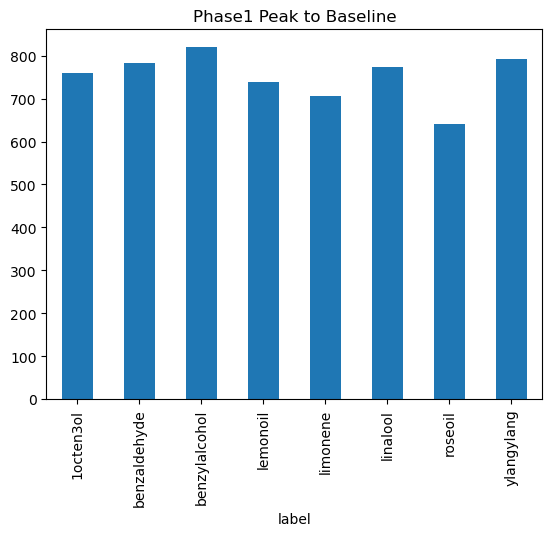

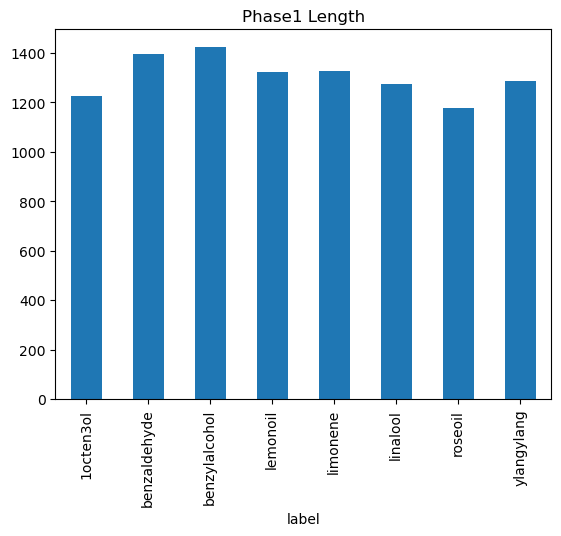

...

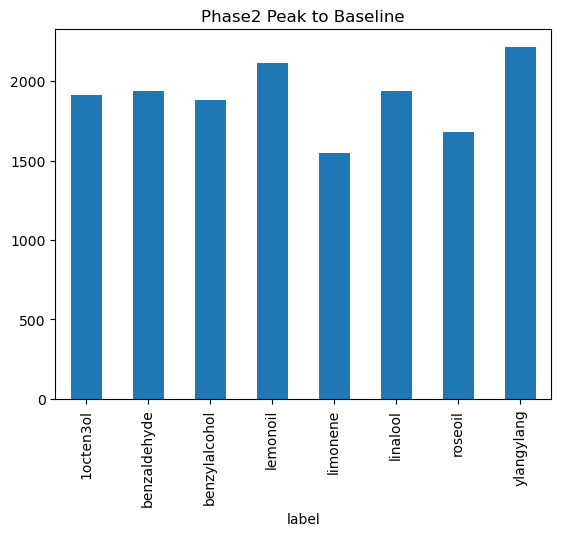

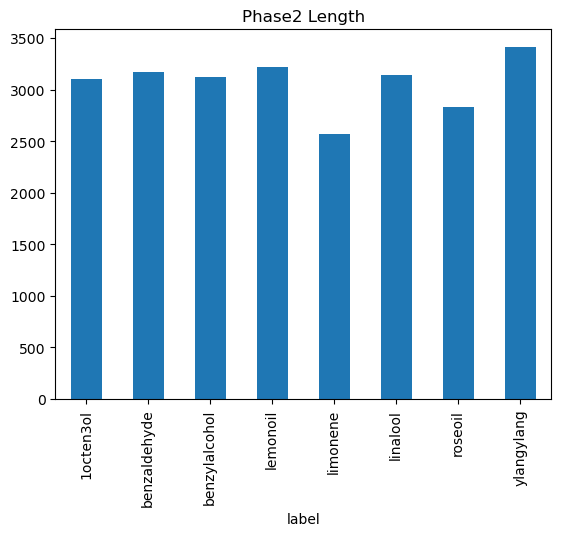

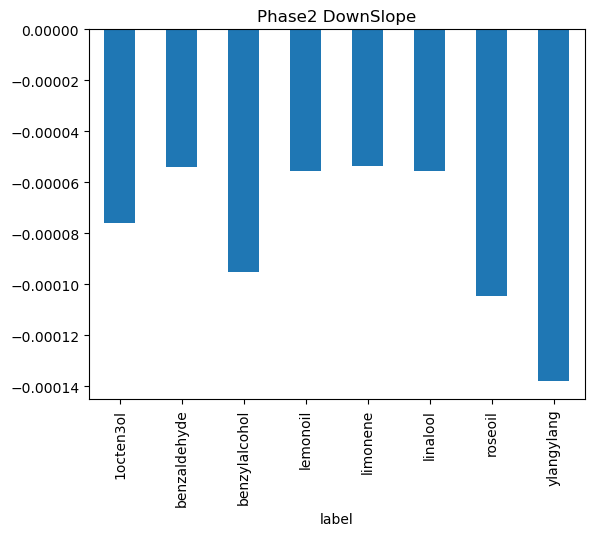

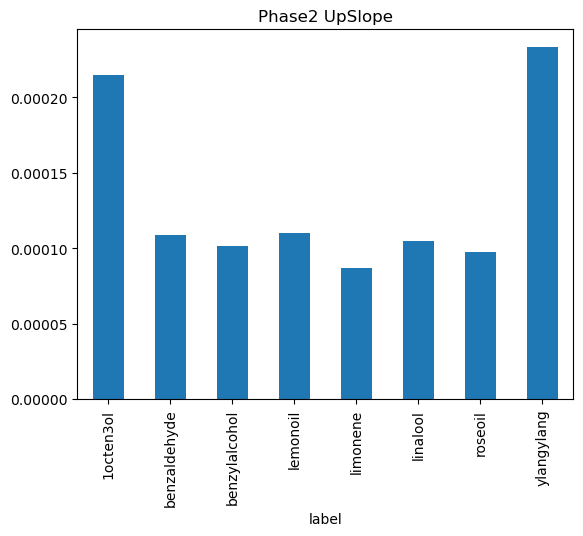

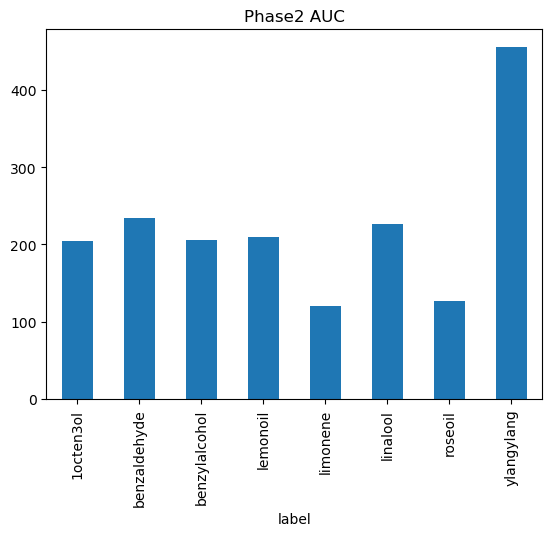

In [140]:
for col in list(CH1_Mean.columns):
    CH1_Mean[col].plot(kind='bar')
    plt.title(col)
    plt.show()

In [124]:
CH1_Mean.iloc[0,0:3].mean()-CH1_Mean.iloc[4,0:3].mean()


-50.120001676526215

In [126]:
import math 

math.dist([CH1_Mean.iloc[0,0:3].mean()], [CH1_Mean.iloc[4,0:3].mean()])


50.120001676526215

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis


In [102]:
BhydeCH1_df=CH1_DF[CH1_DF['label']=='benzaldehyde']
BalcCH1_df=CH1_DF[CH1_DF['label']=='benzylalcohol']
OctCH1_df=CH1_DF[CH1_DF['label']=='1octen3ol']
YYCH1_df=CH1_DF[CH1_DF['label']=='ylangylang']
RoseCH1_df=CH1_DF[CH1_DF['label']=='roseoil']
LemCH1_df=CH1_DF[CH1_DF['label']=='lemonoil']
LinCH1_df=CH1_DF[CH1_DF['label']=='linalool']
LimoCH1_df=CH1_DF[CH1_DF['label']=='limonene']

BhydeCH2_df=CH2_DF[CH2_DF['label']=='benzaldehyde']
BalcCH2_df=CH2_DF[CH2_DF['label']=='benzylalcohol']
OctCH2_df=CH2_DF[CH2_DF['label']=='1octen3ol']
YYCH2_df=CH2_DF[CH2_DF['label']=='ylangylang']
RoseCH2_df=CH2_DF[CH2_DF['label']=='roseoil']
LemCH2_df=CH2_DF[CH2_DF['label']=='lemonoil']
LinCH2_df=CH2_DF[CH2_DF['label']=='linalool']
LimoCH2_df=CH2_DF[CH2_DF['label']=='limonene']

In [264]:
Bhyde_FeatCorr_df=BhydeCH2_df.corrwith(BhydeCH1_df)
Balc_FeatCorr_df=BalcCH2_df.corrwith(BalcCH1_df)
Oct_FeatCorr_df=OctCH2_df.corrwith(OctCH1_df)
YY_FeatCorr_df=YYCH2_df.corrwith(YYCH1_df)
Rose_FeatCorr_df=RoseCH2_df.corrwith(RoseCH1_df)
Lem_FeatCorr_df=LemCH2_df.corrwith(LemCH1_df)
Lin_FeatCorr_df=LinCH2_df.corrwith(LinCH1_df)
Limo_FeatCorr_df=LimoCH2_df.corrwith(LimoCH1_df)


In [340]:
pd.DataFrame(BhydeCH2_df['Phase1 Intensity']).corrwith(BhydeCH1_df['Phase1 Intensity'])[0]

-0.19794312668326747

In [303]:
pd.DataFrame(BhydeCH2_df).corrwith(BhydeCH1_df).index[0],pd.DataFrame(BhydeCH2_df).corrwith(BhydeCH1_df)[0]

('Response Delay', -0.011353057375622377)

In [354]:
from itertools import product
All_Col_combos=product(YYCH2_df.columns,YYCH1_df.columns)


#fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
#axes = axes.flat

# iterate and plot
for x,y in All_Col_combos:
    try:
        corr=pd.DataFrame(YYCH2_df[x]).corrwith(YYCH1_df[y])[0]
        if  corr > .4 or corr <-.4:
            print(corr)
            plt.scatter(YYCH2_df[x], YYCH1_df[y])
    
            plt.title(f'Ch2{x} vs. CH1{y}')#, 
            plt.xlabel(f'Ch2{x}')
            plt.ylabel(f'Ch1{y}')
            plt.show()
    except:
        pass